In [92]:
import os
import sys
root_path = os.path.abspath('./..')
sys.path.insert(0, root_path)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.sparse as sp
import hiddensc
from hiddensc import utils, vis
import scanpy as sc
import scvi
import anndata
from sklearn.exceptions import ConvergenceWarning
import warnings
warnings.simplefilter("ignore", category=ConvergenceWarning)
from scipy.sparse import issparse
from functools import reduce
from matplotlib_venn import venn3

from SpatialPeeler import helpers as hlps
from SpatialPeeler import case_prediction as cpred
from SpatialPeeler import plotting as plot
from SpatialPeeler import gene_identification as gid

In [93]:

RAND_SEED = 28
CASE_COND = 1
np.random.seed(RAND_SEED)
utils.set_random_seed(utils.RANDOM_SEED)
utils.print_module_versions([sc, anndata, scvi, hiddensc])
vis.visual_settings()


adata_merged = sc.read_h5ad('/home/delaram/SpatialPeeler/Data/PSC_liver/PSC_NMF_30.h5ad')
sample_ids = adata_merged.obs['sample_id'].unique().tolist()
# Create a dictionary splitting the merged data by sample
adata_by_sample = {
    sid: adata_merged[adata_merged.obs['sample_id'] == sid].copy()
    for sid in adata_merged.obs['sample_id'].unique()
}
sample_ids = list(adata_by_sample.keys())



Random seed set to 42
scanpy              : 1.10.3
anndata             : 0.11.4
scvi                : 1.2.2.post2
hiddensc            : beta_24.07.23


/home/delaram/anaconda3/envs/hiddensc/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [95]:

from scipy.special import logit
import statsmodels.api as sm

def standalone_logistic(X, y):
    # Add intercept explicitly
    X_with_intercept = sm.add_constant(X)

    # Fit model using statsmodels for inference
    model = sm.Logit(y, X_with_intercept)
    result = model.fit(disp=False)

    predicted_prob = result.predict(X_with_intercept)  # returns P(y=1|x)

    coef = result.params          # includes intercept and weights
    stderr = result.bse           # standard errors for each beta
    pvals = result.pvalues        # p-values (Wald test)

    return predicted_prob, coef, stderr, pvals


def single_factor_logistic_evaluation(adata, factor_key="X_nmf", max_factors=30):
    all_results = []
    X = adata.obsm[factor_key]
    y = adata.obs["status"].values
    sample_ids = adata.obs["sample_id"].values

    for i in range(min(max_factors, X.shape[1])):
        print(f"Evaluating factor {i+1}...")
        Xi = X[:, i].reshape(-1, 1)  # single factor

        # Logistic regression with full inference
        p_hat, coef, stderr, pvals = standalone_logistic(Xi, y)
        logit_p_hat = logit(p_hat)

        # Residuals
        raw_residual = y - p_hat
        pearson_residual = raw_residual / np.sqrt(p_hat * (1 - p_hat))
        deviance_residual = np.sign(raw_residual) * np.sqrt(
            -2 * (y * np.log(p_hat) + (1 - y) * np.log(1 - p_hat))
        )
        scaled_p_hat = p_hat/np.sqrt(p_hat * (1 - p_hat))
        scaled_z = Xi.flatten()/np.sqrt(p_hat * (1 - p_hat))
        random_construct = Xi.flatten() - p_hat
        scaled_random_contruct = random_construct/np.sqrt(p_hat * (1 - p_hat))

        # Save the results
        result = {
            "factor_index": i,
            "coef": float(coef[1]),                    # β (slope)
            "intercept": float(coef[0]),               # β0
            "std_err": float(stderr[1]),               # SE(β)
            "std_err_intercept": float(stderr[0]),     # SE(β0)
            "pval": float(pvals[1]),                   # p(β != 0)
            "pval_intercept": float(pvals[0]),         # p(β0 != 0)
            "p_hat": p_hat,
            "scaled_p_hat": scaled_p_hat,
            "logit_p_hat": logit_p_hat,
            'z' : Xi.flatten(),
            "scaled_z": scaled_z,
            "random_construct": random_construct,
            "scaled_random_contruct": scaled_random_contruct,
            "status": y,
            "sample_id": sample_ids,
            "raw_residual": raw_residual,
            "pearson_residual": pearson_residual,
            "deviance_residual": deviance_residual
            }
        
        all_results.append(result)

    return all_results



In [96]:
##################################################################
########### Running HiDDEN on the NMF ######################
adata = adata_merged.copy()
adata_merged.obsm["X_pca"] = adata_merged.obsm["X_nmf"]  # Use NMF factors as PCA scores

optimal_num_pcs_ks =  adata_merged.obsm["X_nmf"].shape[1]
# Set up HiDDEN input
adata.obsm["X_pca"] = adata.obsm["X_nmf"][:, :optimal_num_pcs_ks]
adata.obs['status'] = adata.obs['binary_label'].astype(int).values

# Run factor-wise HiDDEN-like analysis (logistic regression on single factors)
results = single_factor_logistic_evaluation(
    adata, factor_key="X_pca", max_factors=optimal_num_pcs_ks
)

/home/delaram/anaconda3/envs/hiddensc/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Evaluating factor 1...
Evaluating factor 2...
Evaluating factor 3...
Evaluating factor 4...
Evaluating factor 5...
Evaluating factor 6...
Evaluating factor 7...
Evaluating factor 8...
Evaluating factor 9...


/tmp/ipykernel_1209772/506372634.py:37: RuntimeWarning: invalid value encountered in divide
  pearson_residual = raw_residual / np.sqrt(p_hat * (1 - p_hat))
/tmp/ipykernel_1209772/506372634.py:39: RuntimeWarning: divide by zero encountered in log
  -2 * (y * np.log(p_hat) + (1 - y) * np.log(1 - p_hat))
/tmp/ipykernel_1209772/506372634.py:39: RuntimeWarning: invalid value encountered in multiply
  -2 * (y * np.log(p_hat) + (1 - y) * np.log(1 - p_hat))
/tmp/ipykernel_1209772/506372634.py:41: RuntimeWarning: divide by zero encountered in divide
  scaled_p_hat = p_hat/np.sqrt(p_hat * (1 - p_hat))
/tmp/ipykernel_1209772/506372634.py:42: RuntimeWarning: divide by zero encountered in divide
  scaled_z = Xi.flatten()/np.sqrt(p_hat * (1 - p_hat))
/tmp/ipykernel_1209772/506372634.py:44: RuntimeWarning: divide by zero encountered in divide
  scaled_random_contruct = random_construct/np.sqrt(p_hat * (1 - p_hat))


Evaluating factor 10...
Evaluating factor 11...
Evaluating factor 12...
Evaluating factor 13...
Evaluating factor 14...
Evaluating factor 15...
Evaluating factor 16...
Evaluating factor 17...
Evaluating factor 18...
Evaluating factor 19...
Evaluating factor 20...
Evaluating factor 21...
Evaluating factor 22...
Evaluating factor 23...
Evaluating factor 24...
Evaluating factor 25...
Evaluating factor 26...
Evaluating factor 27...
Evaluating factor 28...
Evaluating factor 29...
Evaluating factor 30...


In [106]:

factor_id = 22
results[factor_id]['p_hat']  # p_hat for the first factor
results[factor_id]['scaled_p_hat']  # p_hat for the first factor
adata_merged.obs['disease']

### create a dataframe 
df_p_hat = pd.DataFrame({
    'disease': adata_merged.obs['disease'],
    'sample_id': adata_merged.obs['sample_id'],
    'p_hat': results[factor_id]['p_hat'],
    'scaled_p_hat': results[factor_id]['scaled_p_hat'],
    'pearson_residual': results[factor_id]['pearson_residual'],
    'raw_residual': results[factor_id]['raw_residual'],
    "logit_p_hat": results[factor_id]['logit_p_hat'],
    "z": results[factor_id]['z'],
    "scaled_z": results[factor_id]['scaled_z'],
    "random_construct": results[factor_id]['random_construct'],
    "scaled_random_contruct": results[factor_id]['scaled_random_contruct'],
    "status": results[factor_id]['status'],
    "deviance_residual": results[factor_id]['deviance_residual'],
    'p_hat_power' : results[factor_id]['p_hat'] ** 4
})




status
1    12284
0     9269
Name: count, dtype: int64
count   21553.000
mean        0.570
std         0.339
min         0.000
25%         0.236
50%         0.716
75%         0.889
max         0.889
Name: p_hat, dtype: float64


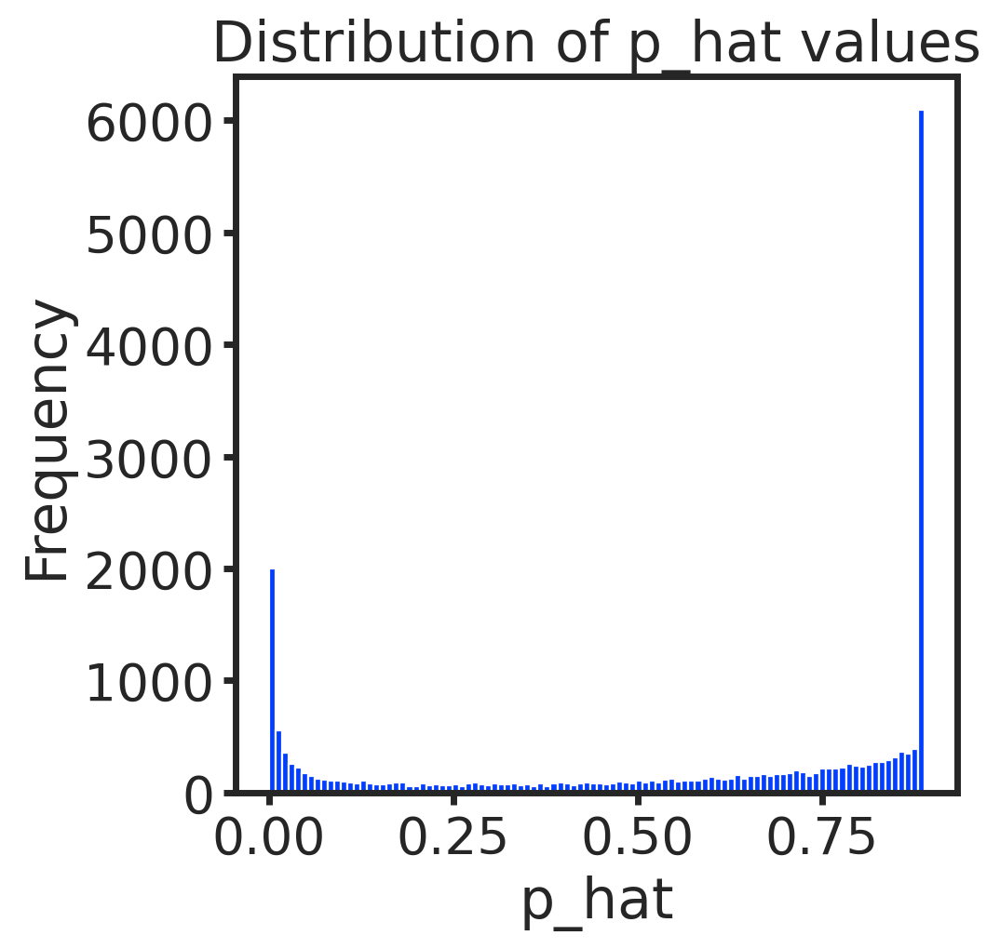

summary stats of zi:  count   21553.000
mean        0.021
std         0.026
min         0.000
25%         0.000
50%         0.011
75%         0.031
max         0.144
Name: z, dtype: float64


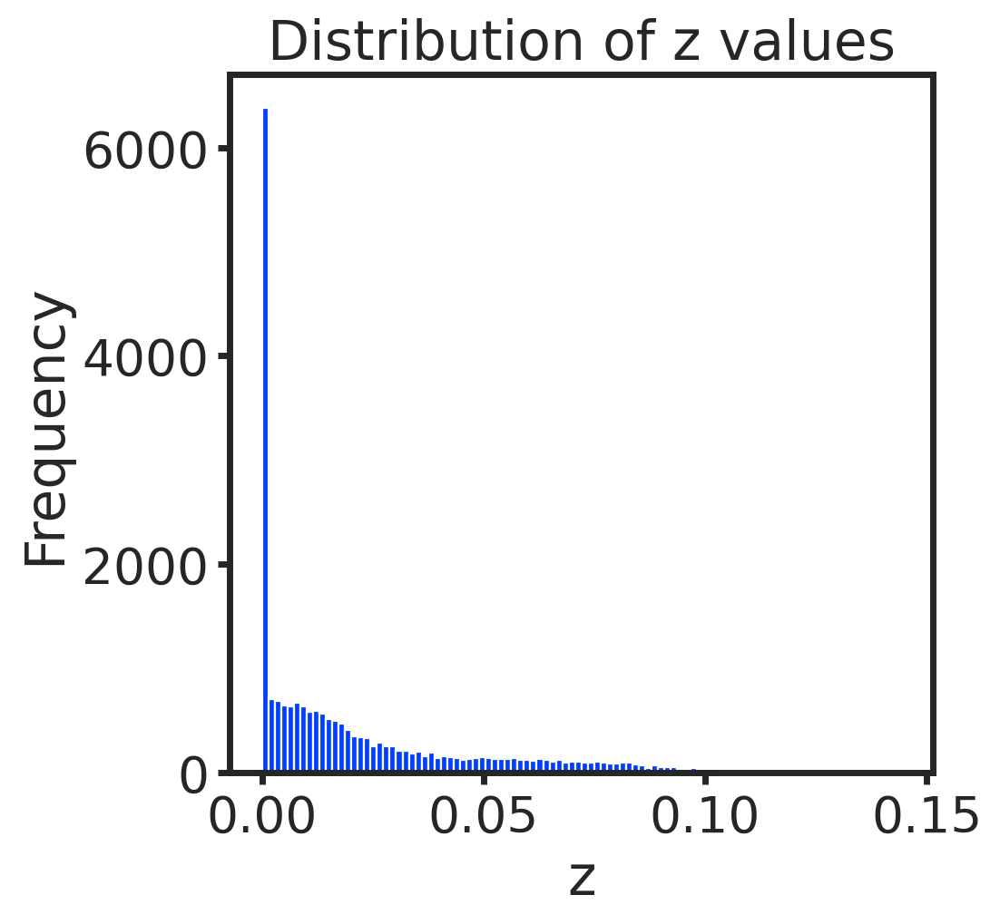

count   21553.000
mean        1.578
std         1.048
min         0.002
25%         0.556
50%         1.587
75%         2.835
max         2.835
Name: scaled_p_hat, dtype: float64


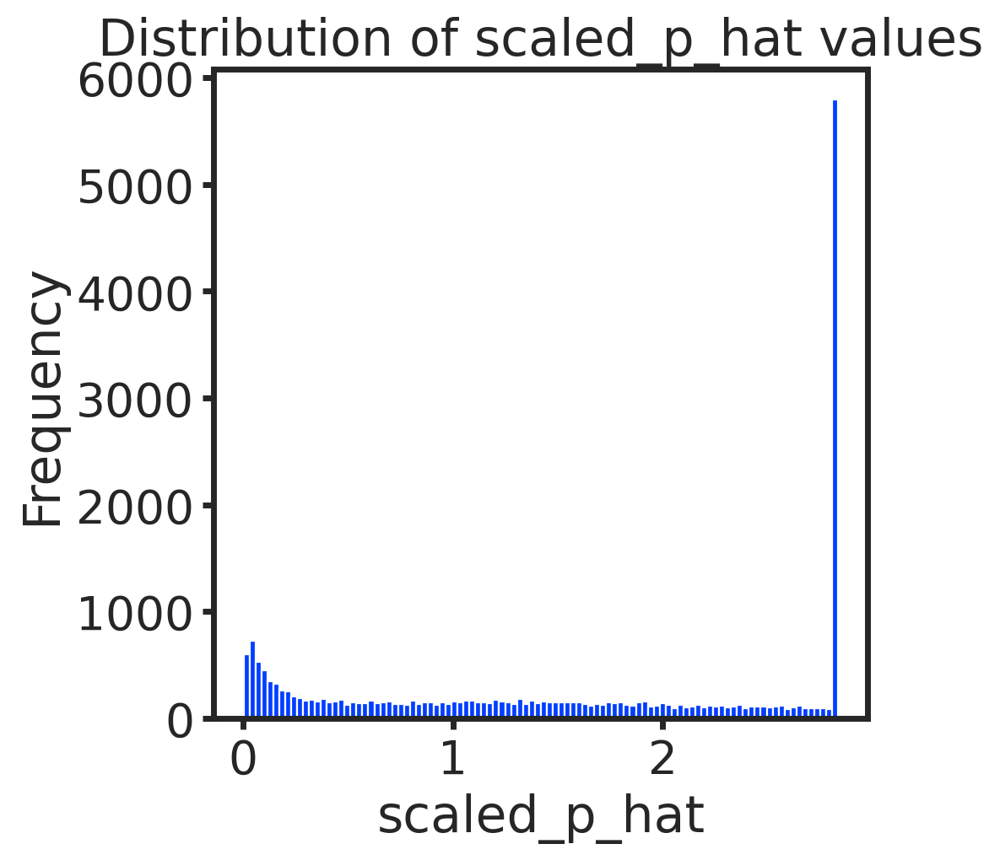

count   21553.000
mean       -0.114
std         2.694
min       -12.913
25%        -1.173
50%         0.924
75%         2.084
max         2.084
Name: logit_p_hat, dtype: float64


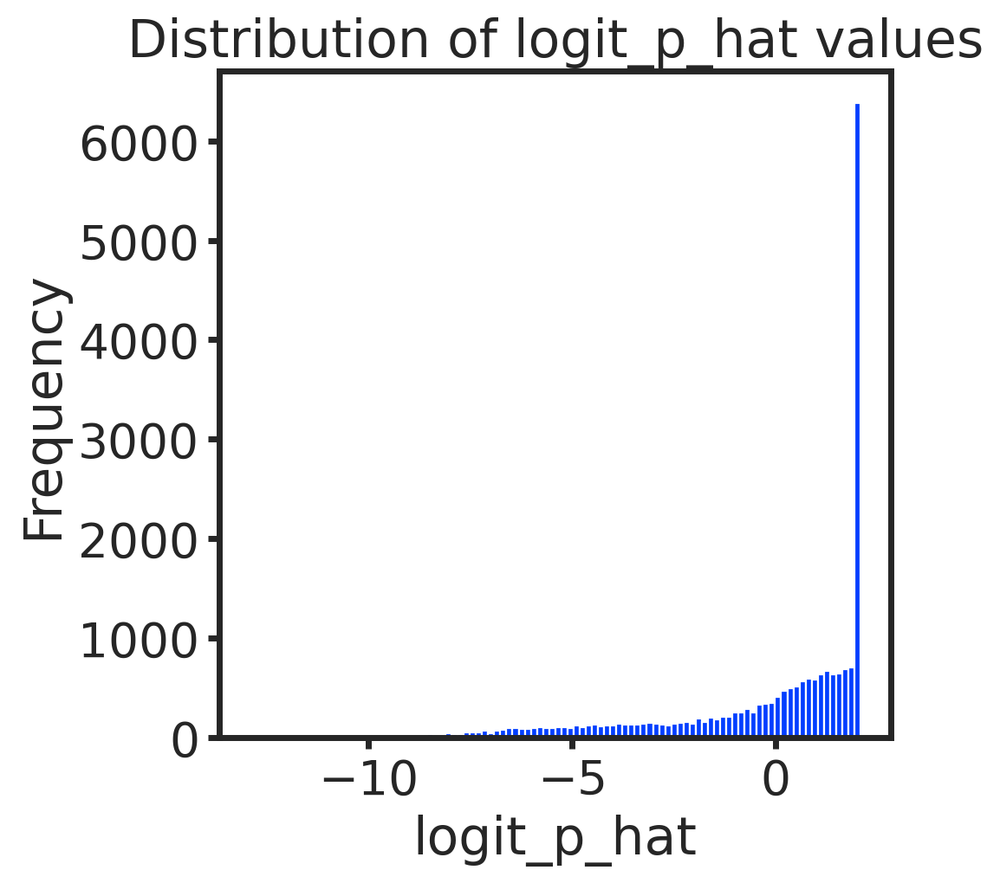

count   21553.000
mean       -0.549
std         0.363
min        -0.889
25%        -0.889
50%        -0.705
75%        -0.205
max         0.144
Name: random_construct, dtype: float64


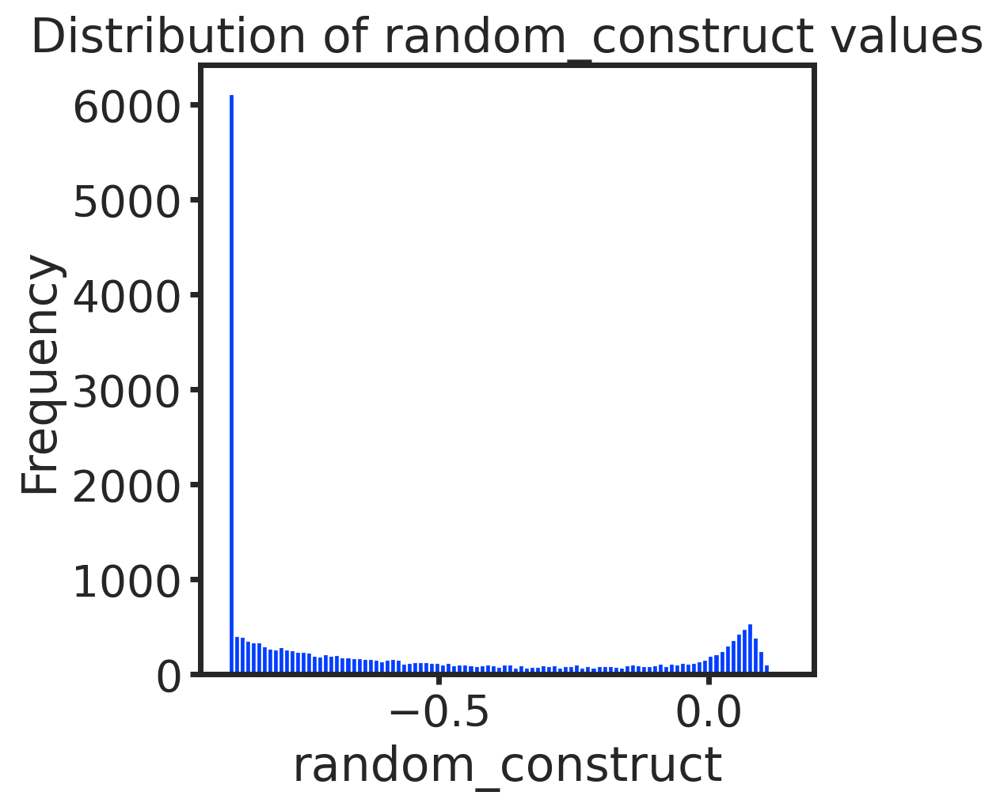

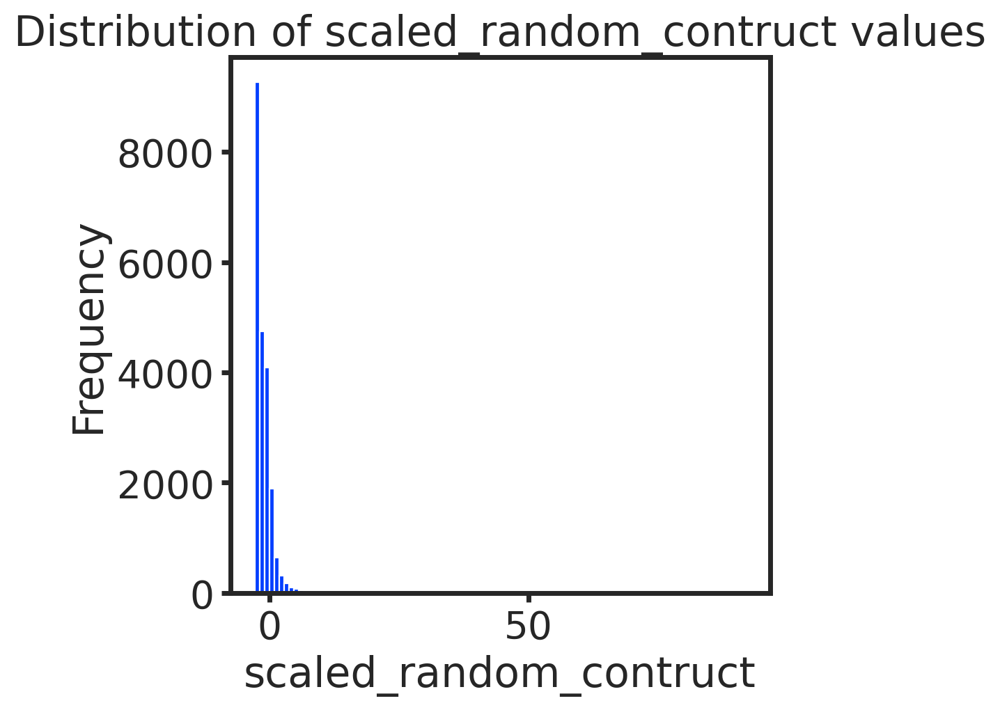

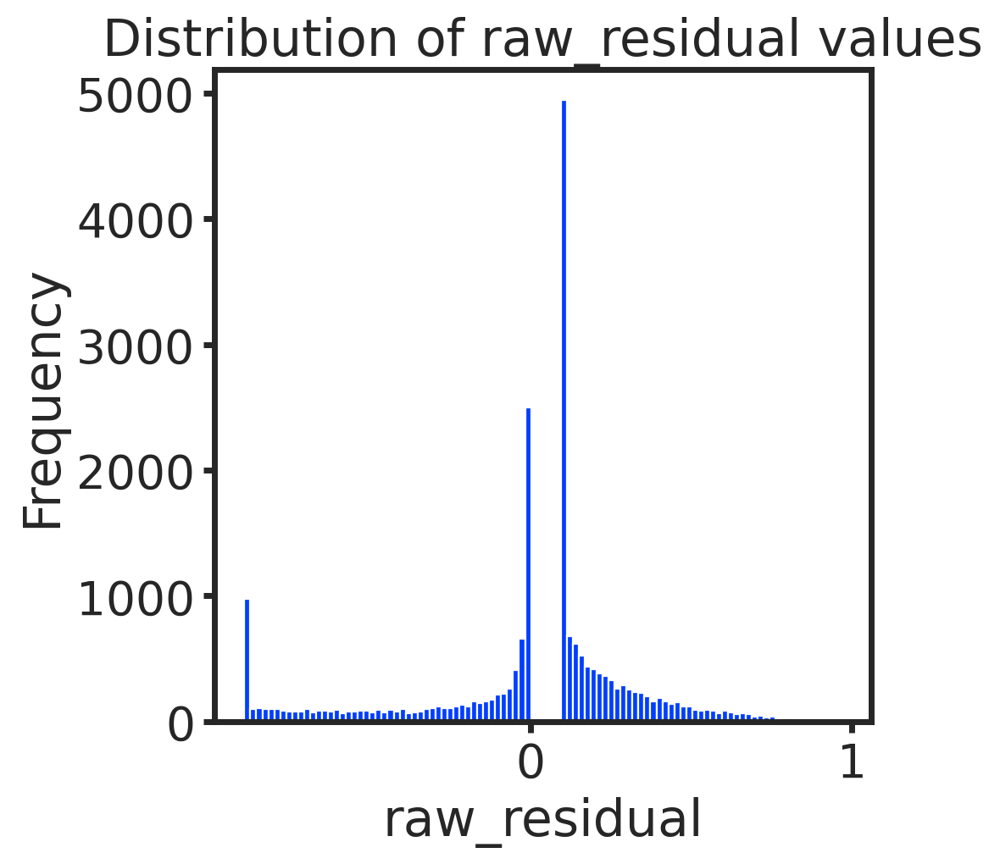

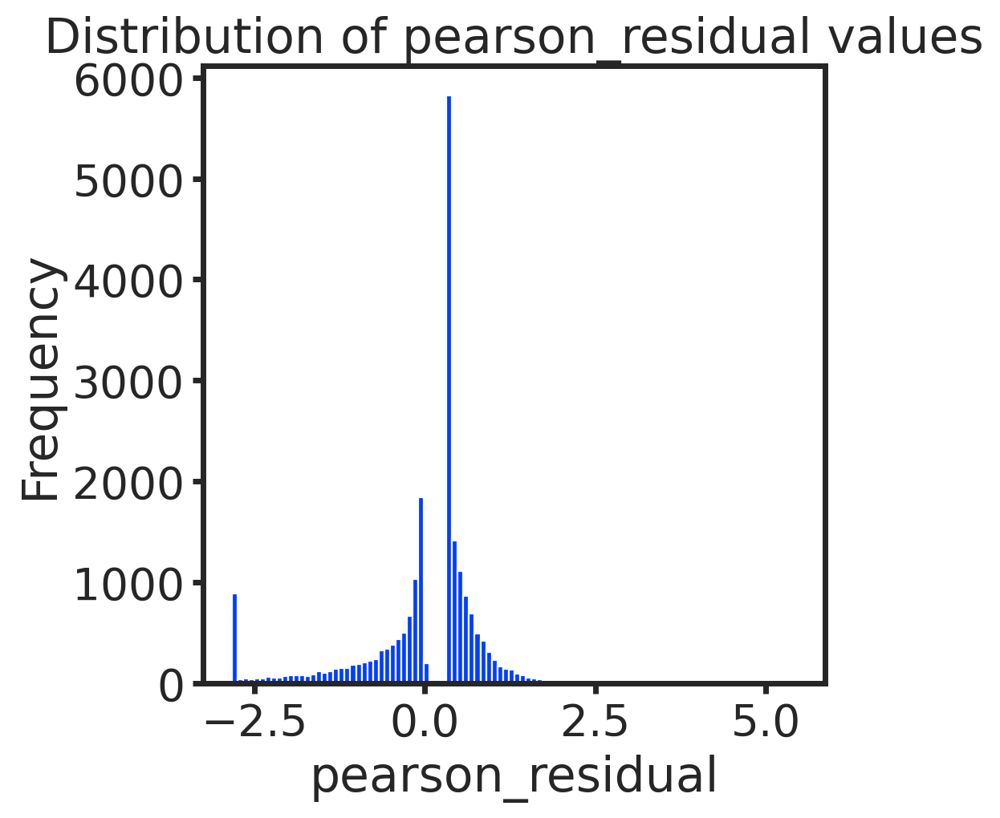

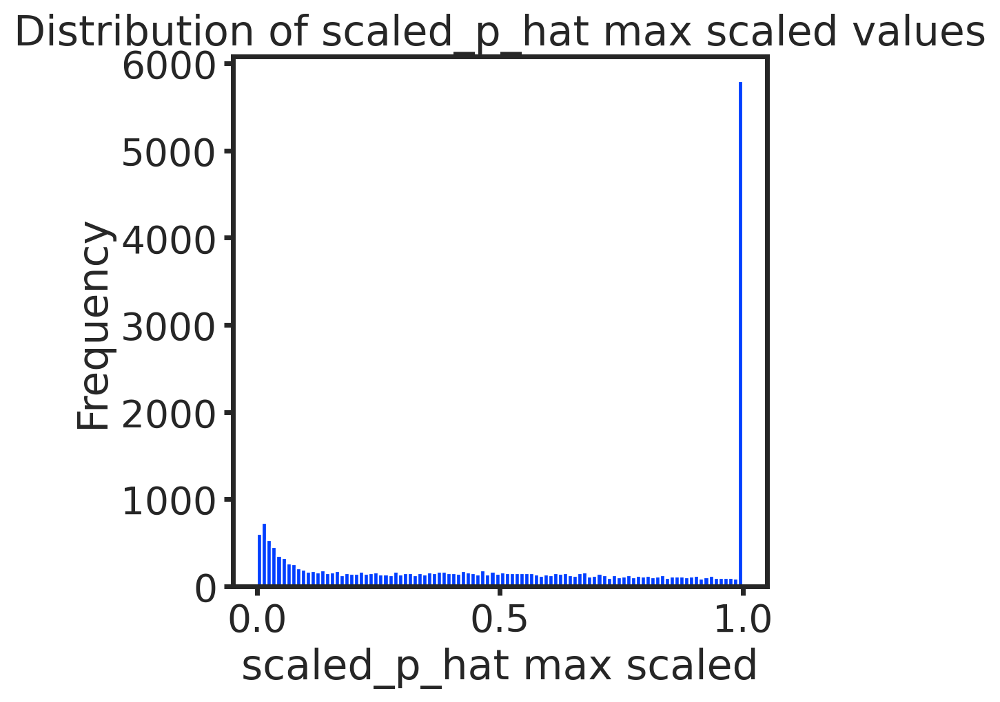

In [107]:
print(df_p_hat['status'].value_counts() )

print(df_p_hat['p_hat'].describe())
plt.figure(figsize=(5,5))
plt.hist(df_p_hat['p_hat'], bins=100)
plt.xlabel('p_hat')
plt.ylabel('Frequency')
plt.title('Distribution of p_hat values')
plt.show()


print("summary stats of zi: ", df_p_hat['z'].describe())
plt.figure(figsize=(5,5))
plt.hist(df_p_hat['z'], bins=100)
plt.xlabel('z')
plt.ylabel('Frequency')
plt.title('Distribution of z values')
plt.show()

print(df_p_hat['scaled_p_hat'].describe())
plt.figure(figsize=(5,5))
plt.hist(df_p_hat['scaled_p_hat'], bins=100)
plt.xlabel('scaled_p_hat')
plt.ylabel('Frequency')
plt.title('Distribution of scaled_p_hat values')
plt.show()


print(df_p_hat['logit_p_hat'].describe())
plt.figure(figsize=(5,5))
plt.hist(df_p_hat['logit_p_hat'], bins=100)
plt.xlabel('logit_p_hat')
plt.ylabel('Frequency')
plt.title('Distribution of logit_p_hat values')
plt.show()

print(df_p_hat['random_construct'].describe())
plt.figure(figsize=(5,5))
plt.hist(df_p_hat['random_construct'], bins=100)
plt.xlabel('random_construct')
plt.ylabel('Frequency')
plt.title('Distribution of random_construct values')
plt.show()

plt.figure(figsize=(5,5))
plt.hist(df_p_hat['scaled_random_contruct'], bins=100)
plt.xlabel('scaled_random_contruct')
plt.ylabel('Frequency')
plt.title('Distribution of scaled_random_contruct values')
plt.show()

plt.figure(figsize=(5,5))
plt.hist(df_p_hat['raw_residual'], bins=100)
plt.xlabel('raw_residual')
plt.ylabel('Frequency')
plt.title('Distribution of raw_residual values')
plt.show()


plt.figure(figsize=(5,5))
plt.hist(df_p_hat['pearson_residual'], bins=100)
plt.xlabel('pearson_residual')
plt.ylabel('Frequency')
plt.title('Distribution of pearson_residual values')
plt.show()

plt.figure(figsize=(5,5))
plt.hist(df_p_hat['scaled_p_hat']/max(df_p_hat['scaled_p_hat']), bins=100)
plt.xlabel('scaled_p_hat max scaled')
plt.ylabel('Frequency')
plt.title('Distribution of scaled_p_hat max scaled values')
plt.show()


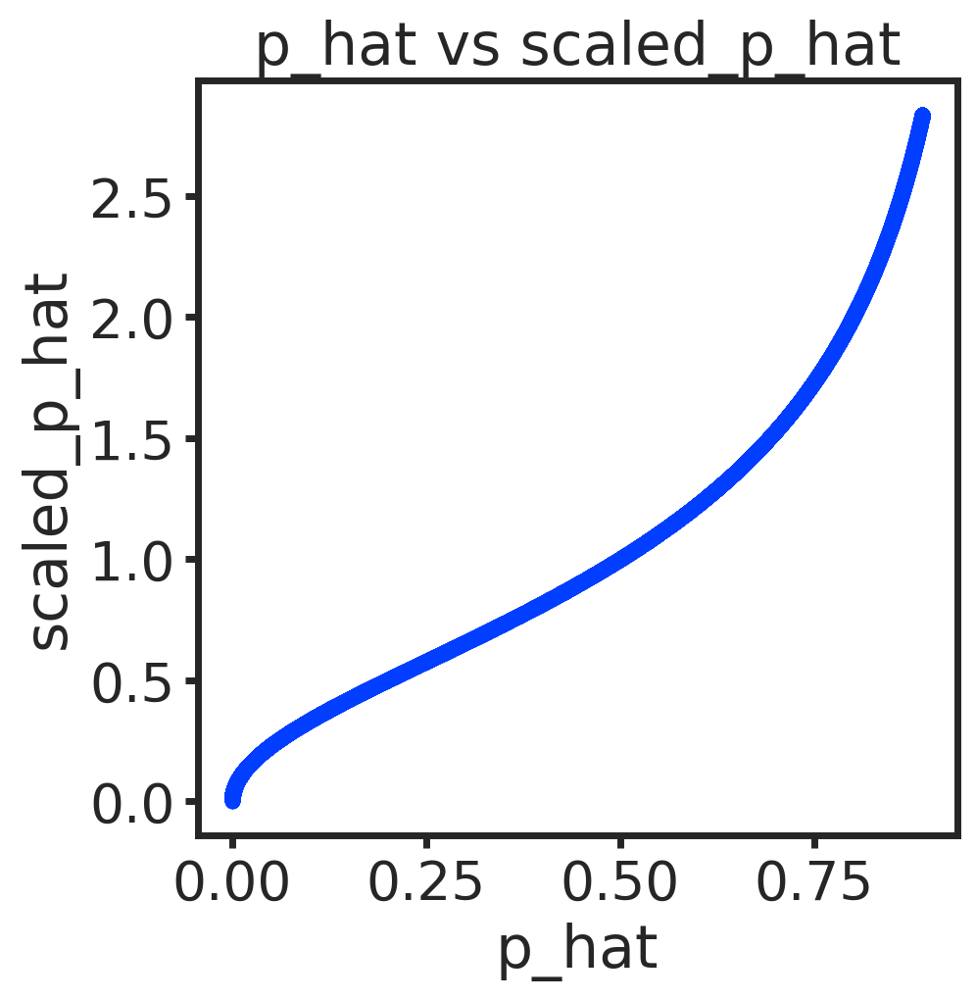

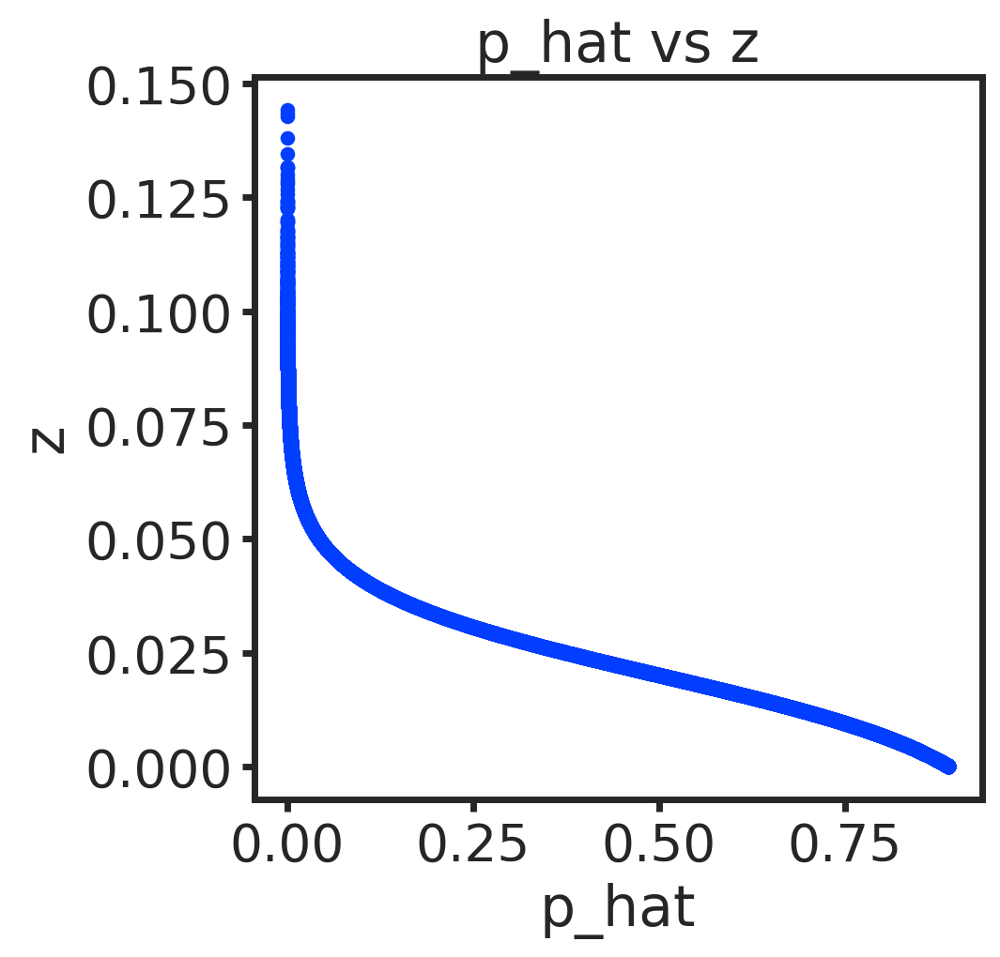

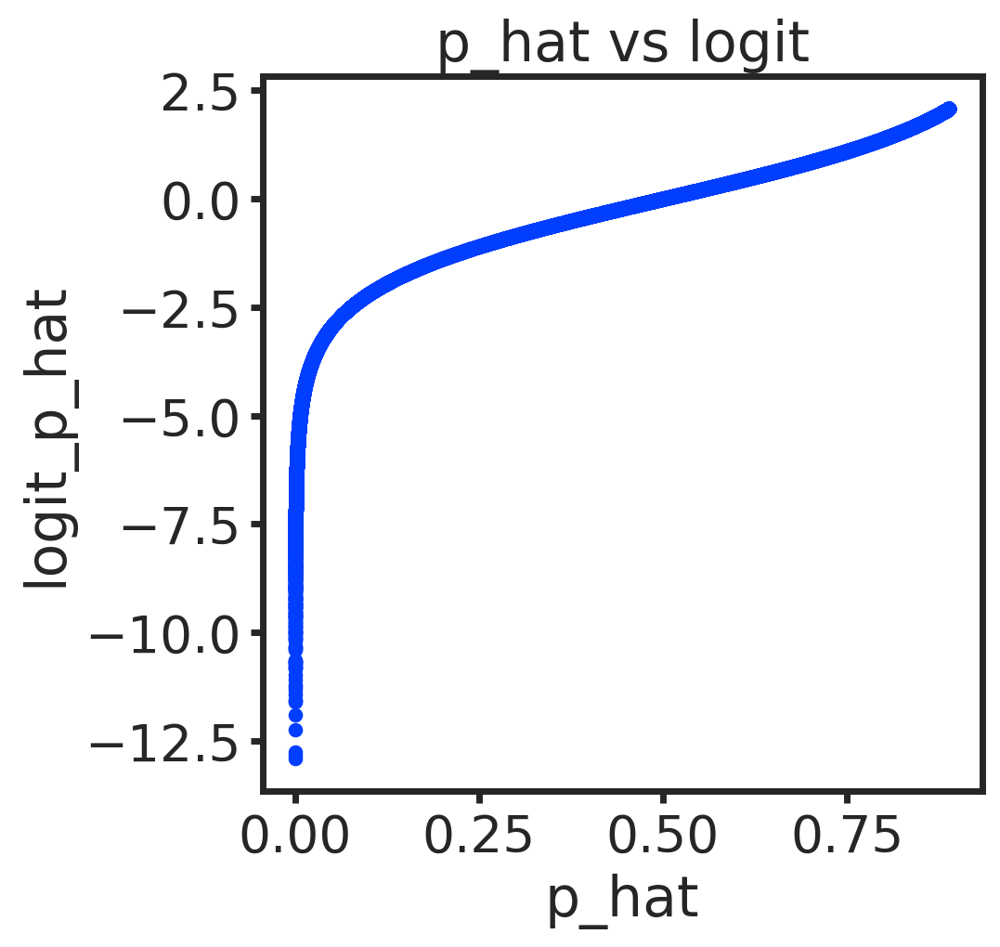

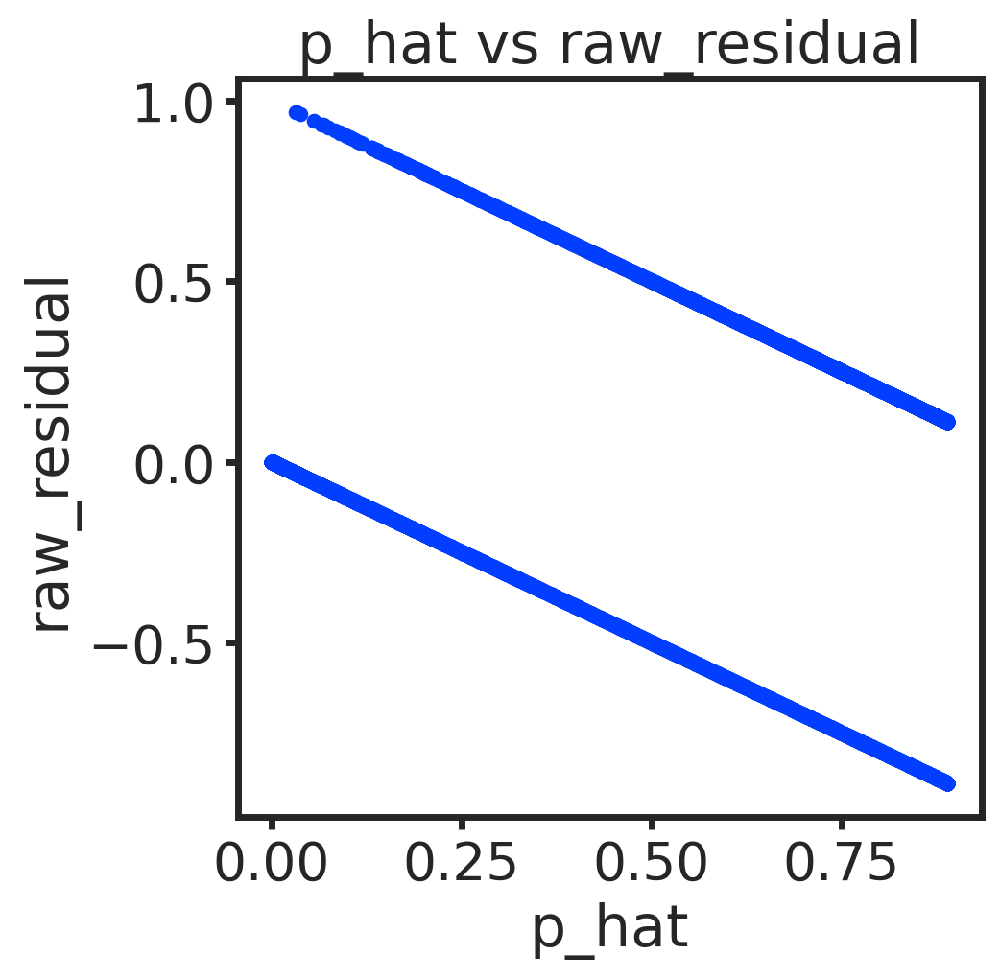

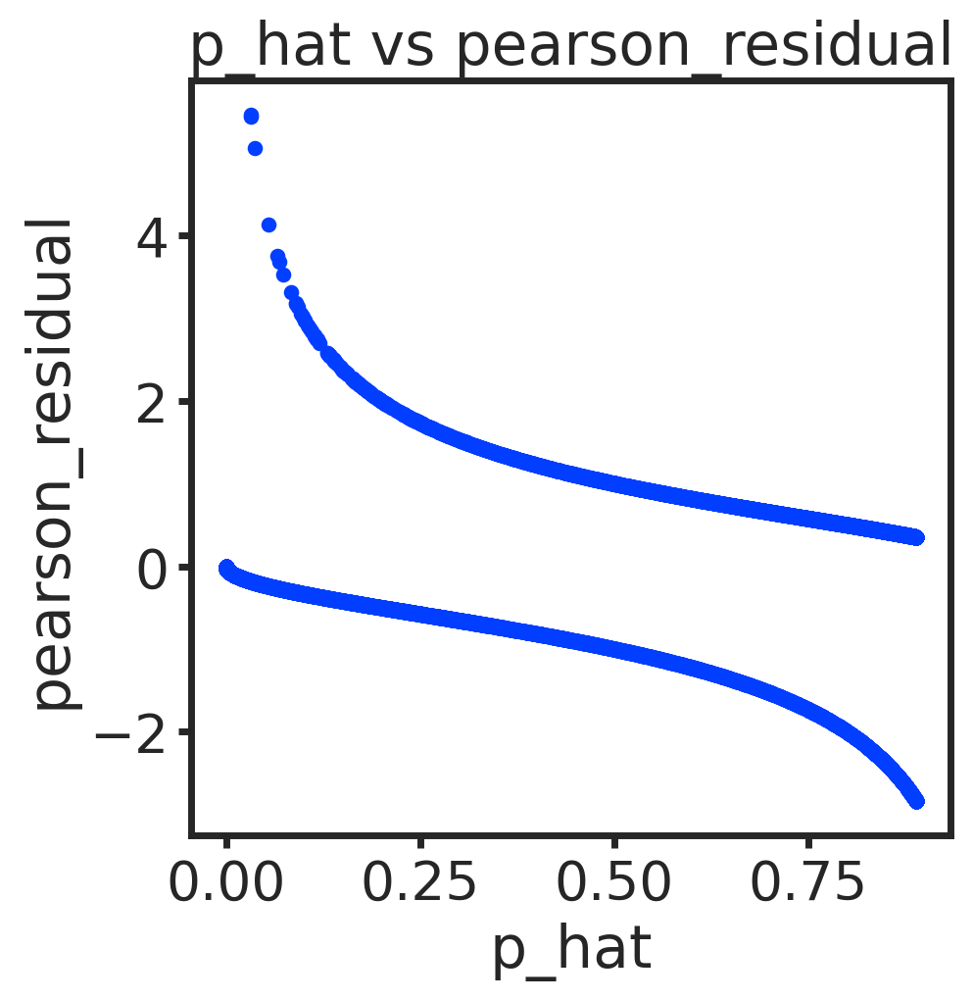

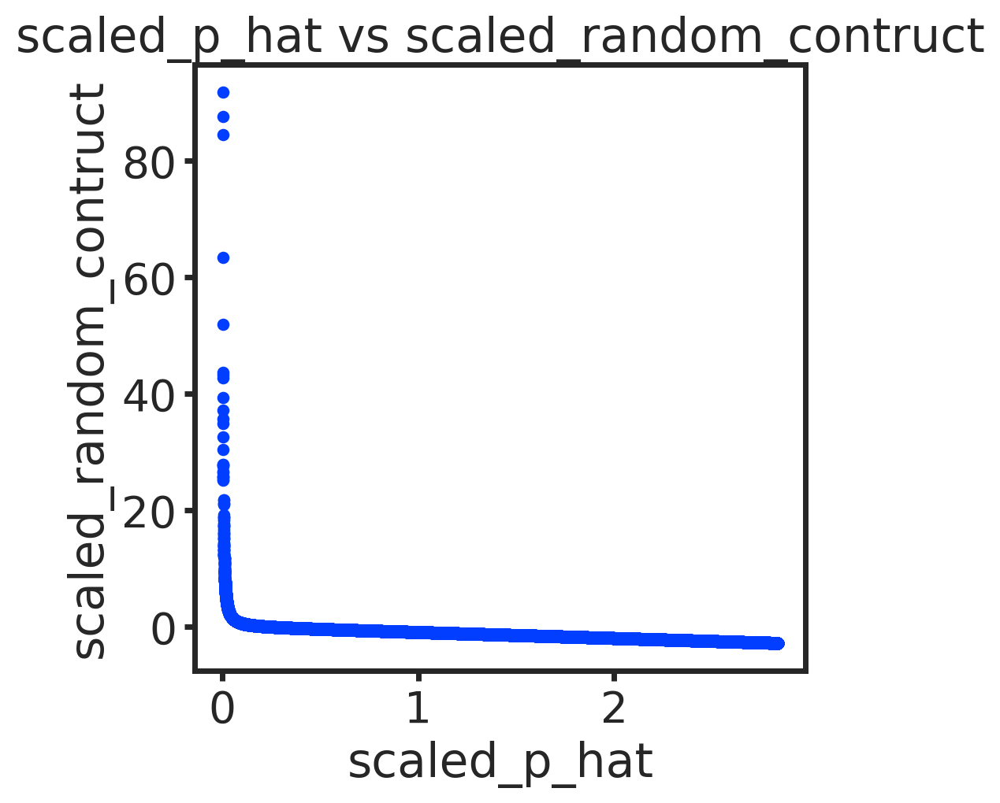

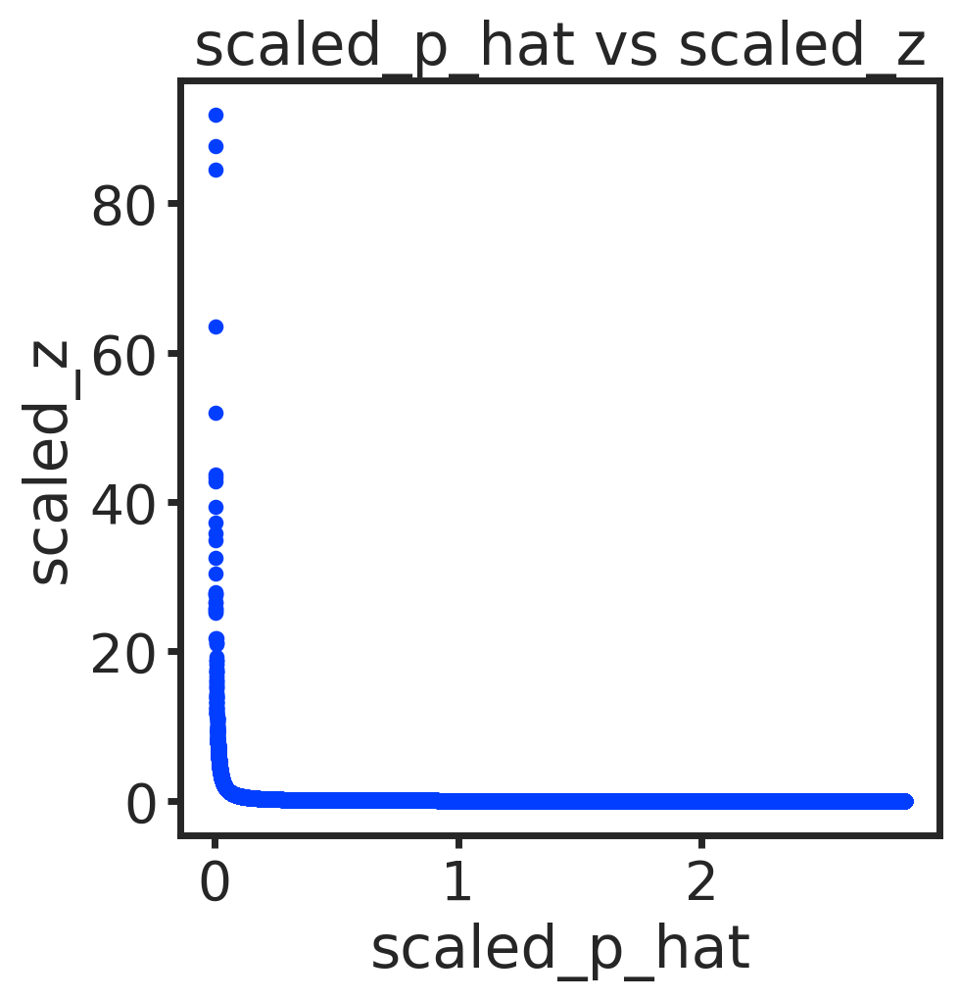

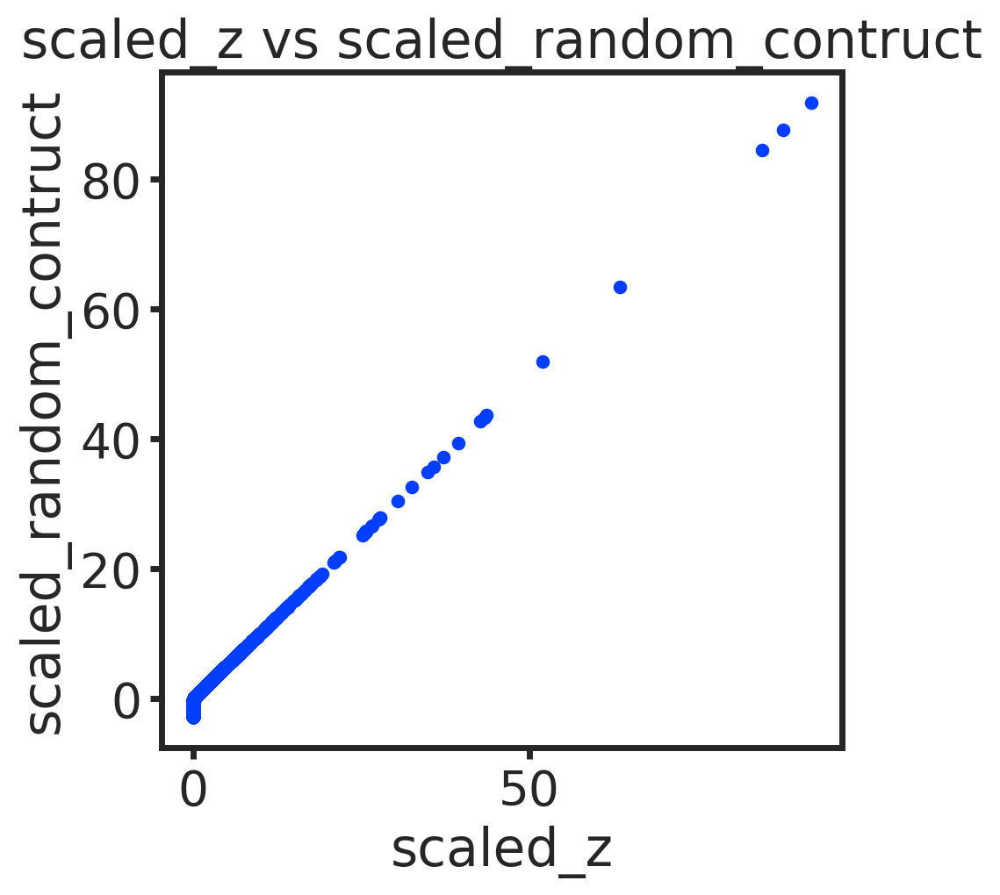

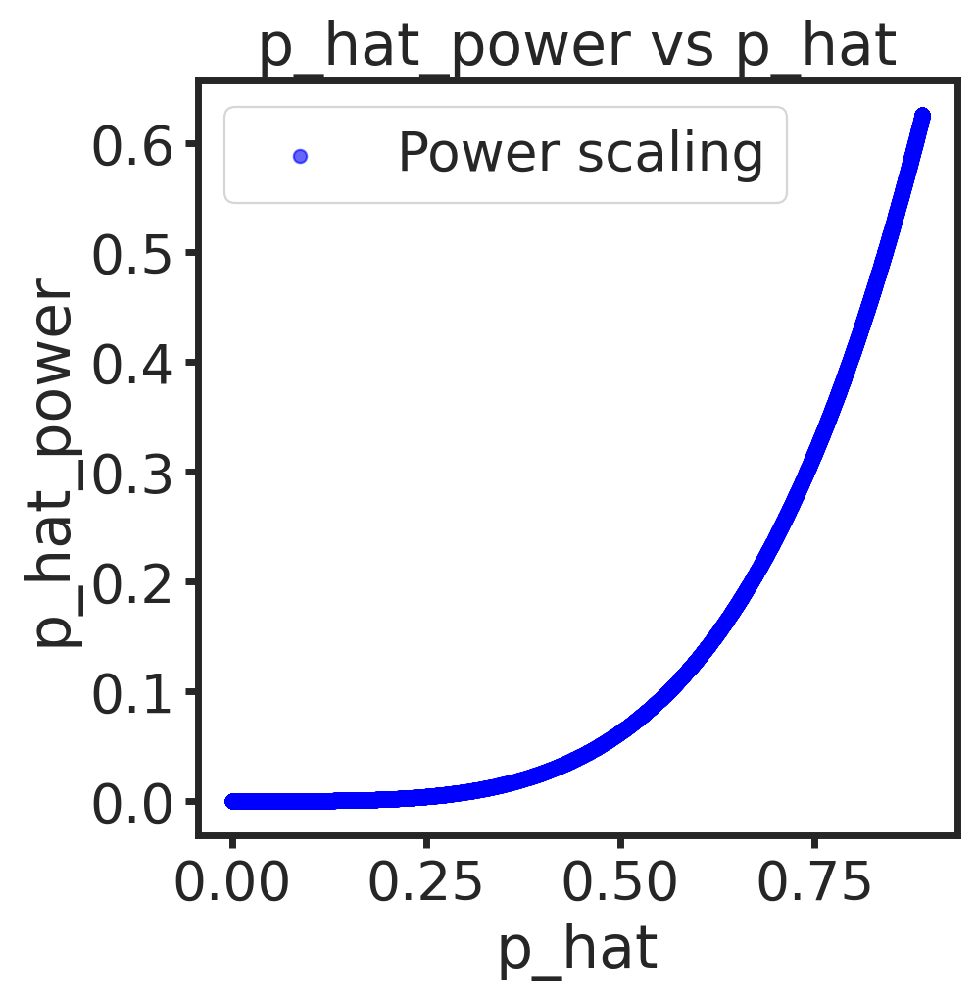

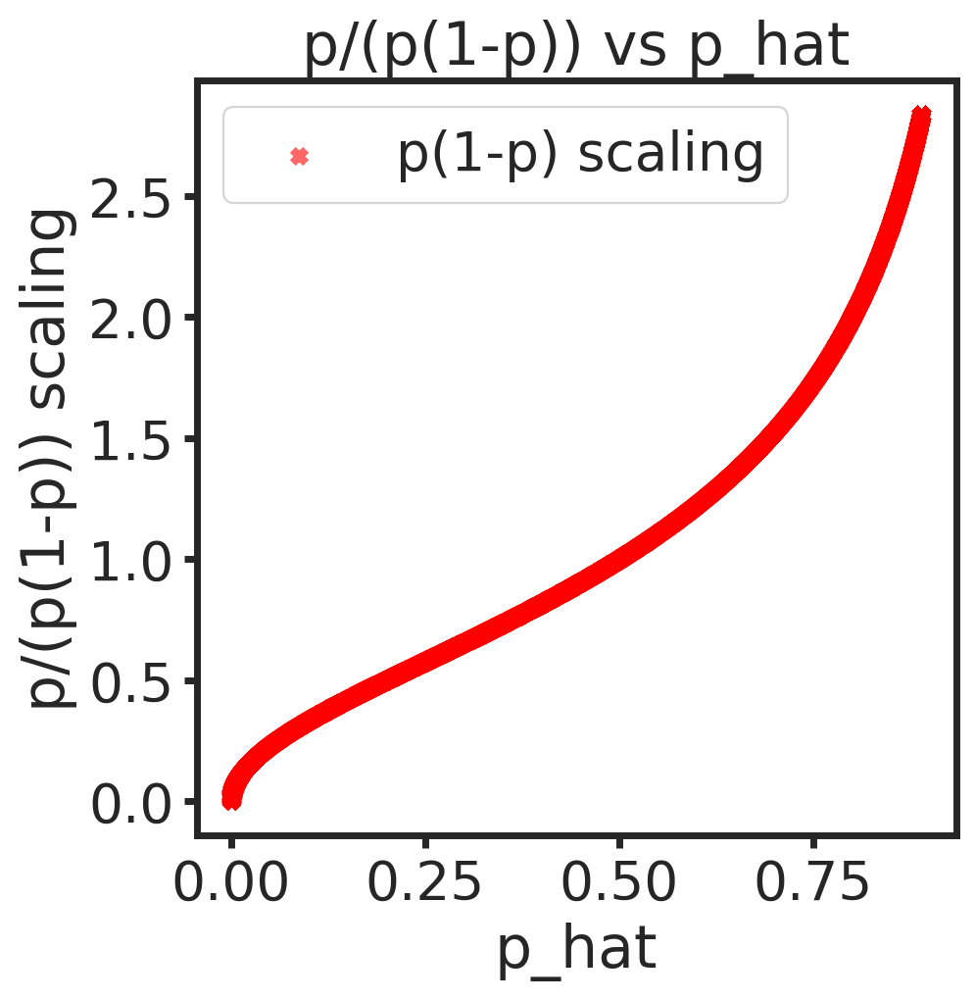

In [108]:

plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['p_hat'].values, 
            df_p_hat['scaled_p_hat'].values)
plt.xlabel('p_hat')
plt.ylabel('scaled_p_hat')
plt.title('p_hat vs scaled_p_hat')
plt.show()

plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['p_hat'].values, 
            df_p_hat['z'].values)
plt.xlabel('p_hat')
plt.ylabel('z')
plt.title('p_hat vs z')
plt.show()

plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['p_hat'].values, 
            df_p_hat['logit_p_hat'].values)
plt.xlabel('p_hat')
plt.ylabel('logit_p_hat')
plt.title('p_hat vs logit')
plt.show()


plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['p_hat'].values, 
            df_p_hat['raw_residual'].values)
plt.xlabel('p_hat')
plt.ylabel('raw_residual')
plt.title('p_hat vs raw_residual')
plt.show()


plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['p_hat'].values, 
            df_p_hat['pearson_residual'].values)
plt.xlabel('p_hat')
plt.ylabel('pearson_residual')
plt.title('p_hat vs pearson_residual')
plt.show()

plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['scaled_p_hat'].values, 
            df_p_hat['scaled_random_contruct'].values)
plt.xlabel('scaled_p_hat')
plt.ylabel('scaled_random_contruct')
plt.title('scaled_p_hat vs scaled_random_contruct')
plt.show()


plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['scaled_p_hat'].values, 
            df_p_hat['scaled_z'].values)
plt.xlabel('scaled_p_hat')
plt.ylabel('scaled_z')
plt.title('scaled_p_hat vs scaled_z')
plt.show()


plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['scaled_z'].values,
            df_p_hat['scaled_random_contruct'].values)
plt.xlabel('scaled_z')
plt.ylabel('scaled_random_contruct')
plt.title('scaled_z vs scaled_random_contruct')
plt.show()


plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['p_hat'].values, df_p_hat['p_hat_power'].values, color='blue', label='Power scaling', alpha=0.6, marker='o')
plt.xlabel('p_hat')
plt.ylabel('p_hat_power')
plt.title('p_hat_power vs p_hat')
plt.legend()
plt.show()


plt.figure(figsize=(5,5))
plt.scatter(df_p_hat['p_hat'].values, df_p_hat['scaled_p_hat'].values, color='red', label='p(1-p) scaling', alpha=0.6, marker='x')
plt.xlabel('p_hat')
plt.ylabel('p/(p(1-p)) scaling')
plt.title('p/(p(1-p)) vs p_hat')
plt.legend()
plt.show()



/tmp/ipykernel_1209772/2329678508.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(y="status", x="disease",
/tmp/ipykernel_1209772/2329678508.py:4: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')


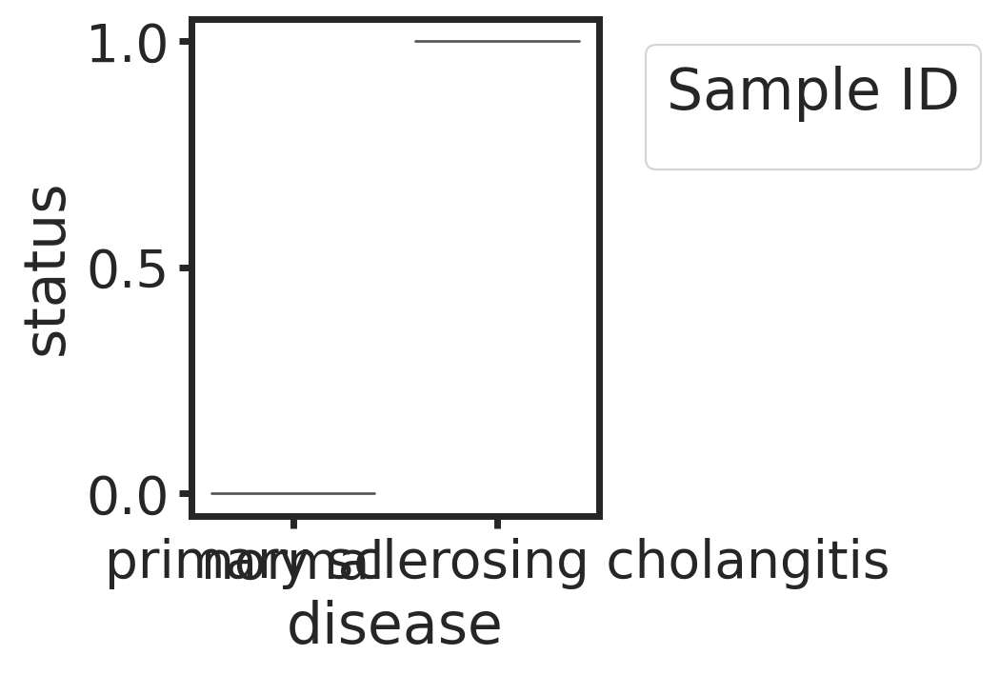

/tmp/ipykernel_1209772/2329678508.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(y="p_hat", x="disease",
/tmp/ipykernel_1209772/2329678508.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')


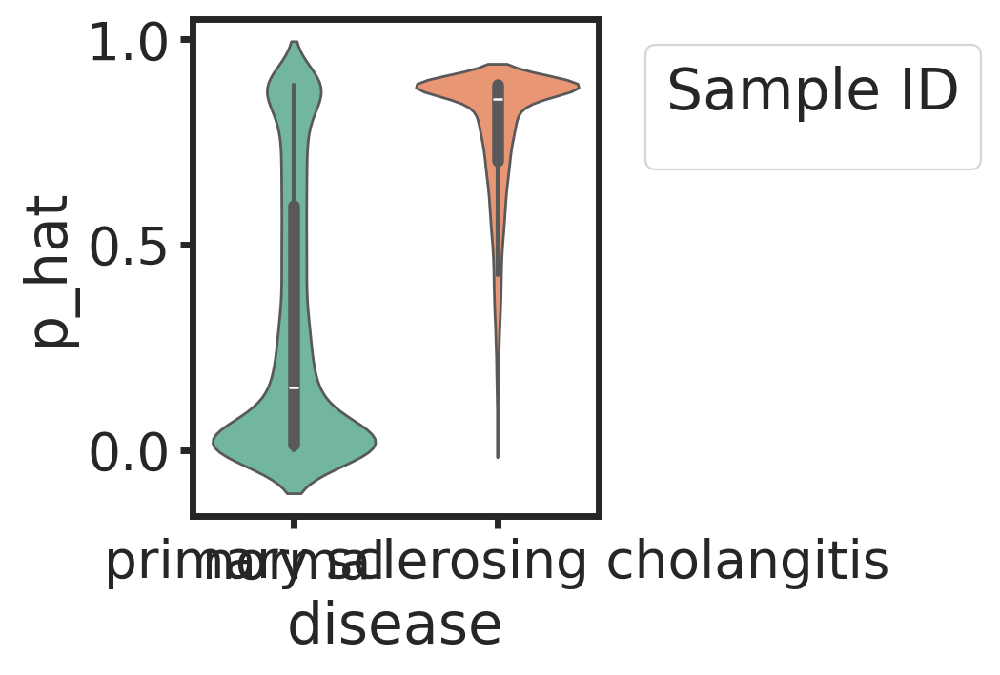

/tmp/ipykernel_1209772/2329678508.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(y="p_hat_power", x="disease",
/tmp/ipykernel_1209772/2329678508.py:18: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')


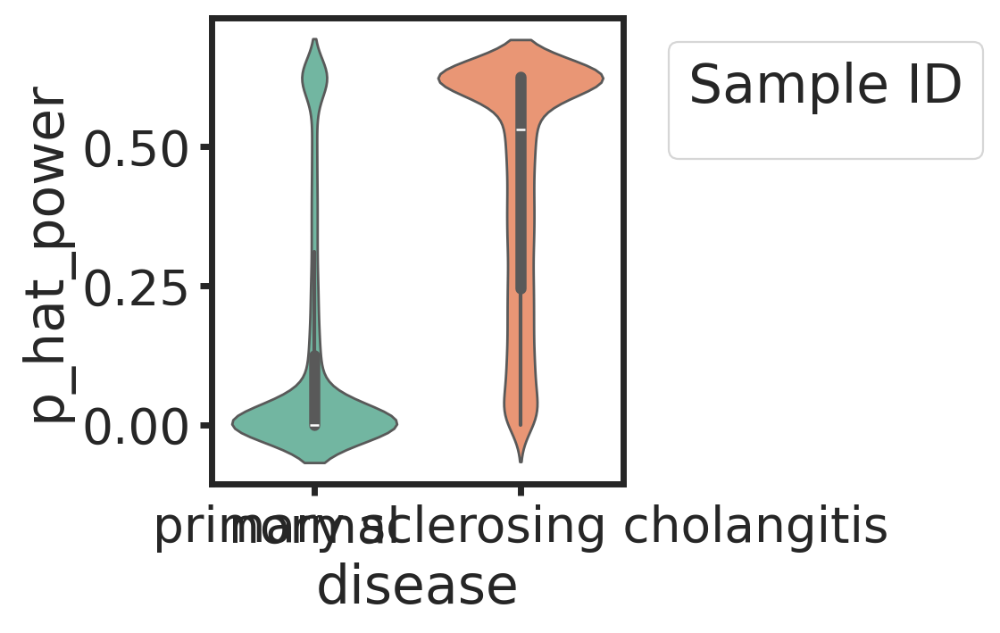

/tmp/ipykernel_1209772/2329678508.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(y="scaled_p_hat", x="disease",
/tmp/ipykernel_1209772/2329678508.py:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')


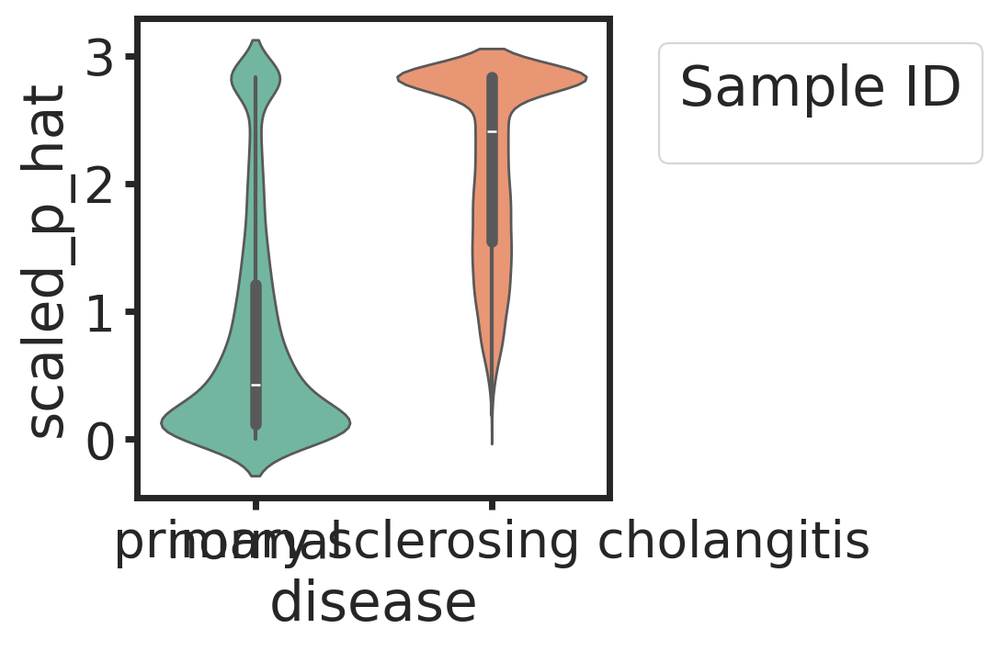

/tmp/ipykernel_1209772/2329678508.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(y="scaled_random_contruct", x="disease",
/tmp/ipykernel_1209772/2329678508.py:32: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')


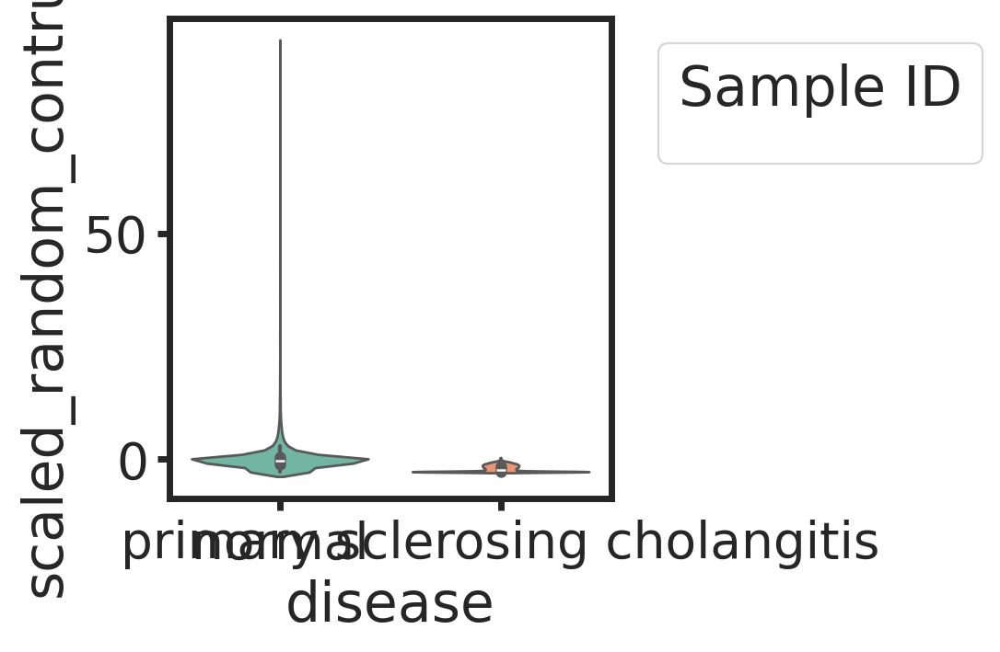

In [109]:
plt.figure(figsize=(6, 4))
sns.violinplot(y="status", x="disease",  
               data=df_p_hat, inner="box", palette="Set2")
plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 4))
sns.violinplot(y="p_hat", x="disease",  
               data=df_p_hat, inner="box", palette="Set2")
plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 4))
sns.violinplot(y="p_hat_power", x="disease",  
               data=df_p_hat, inner="box", palette="Set2")
plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 4))
sns.violinplot(y="scaled_p_hat", x="disease",  
               data=df_p_hat, inner="box", palette="Set2")
plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 4))
sns.violinplot(y="scaled_random_contruct", x="disease",  
               data=df_p_hat, inner="box", palette="Set2")
plt.legend(title="Sample ID", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

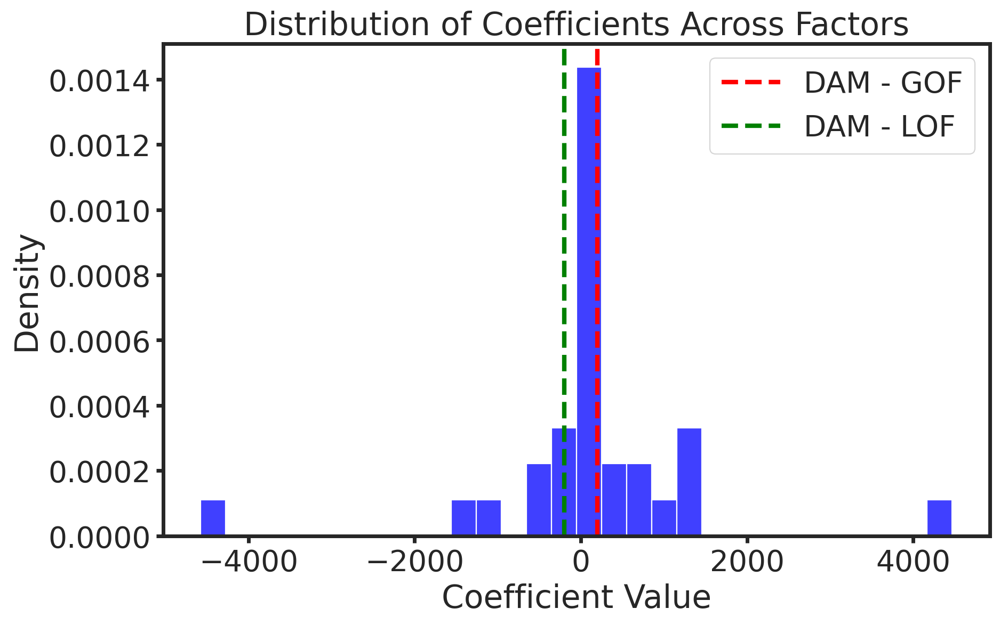

In [110]:

# Extract full model stats for each factor
coef_list = [res['coef'] for res in results]
intercept_list = [res['intercept'] for res in results]
stderr_list = [res.get('std_err', None) for res in results]
stderr_intercept_list = [res.get('std_err_intercept', None) for res in results]
pval_list = [res.get('pval', None) for res in results]
pval_intercept_list = [res.get('pval_intercept', None) for res in results]
factor_index_list = [res['factor_index'] for res in results]

# Build summary DataFrame
coef_df = pd.DataFrame({
    'factor': [f'Factor_{i+1}' for i in factor_index_list],
    'coef': coef_list,
    'intercept': intercept_list,
    'std_err': stderr_list,
    'std_err_intercept': stderr_intercept_list,
    'pval': pval_list,
    'pval_intercept': pval_intercept_list
})
coef_df_sorted = coef_df.sort_values(by='coef', ascending=False)
coef_df_sorted

### draw histogram of coefficients
plt.figure(figsize=(10, 6))
sns.histplot(coef_df['coef'], bins=30, kde=False, color='blue', stat='density')
plt.title("Distribution of Coefficients Across Factors")
plt.xlabel("Coefficient Value")
plt.ylabel("Density")
plt.axvline(x=200, color='red', linestyle='--', label='DAM - GOF')
plt.axvline(x=-200, color='green', linestyle='--', label='DAM - LOF')
plt.legend()
plt.show()



In [112]:

# Store output for the best-performing factor (e.g., first one, or pick based on AUC)
#factor_id = 22
counter = factor_id
result = results[counter]
#for result in results[10:26]:
print(f"Factor {result['factor_index'] + 1}:")
print(f"  p_hat mean: {result['p_hat'].mean():.4f}")
print(f"  Status distribution: {np.bincount(result['status'])}")

adata.obs['p_hat'] = result['p_hat']
adata.obs['p_hat'] = adata.obs['p_hat'].astype('float32')
adata.obs['1_p_hat'] = 1 - adata.obs['p_hat'].astype('float32')

adata.obs['scaled_p_hat'] = result['scaled_p_hat']
adata.obs['1_scaled_p_hat'] = 1 - result['scaled_p_hat']

adata.obs['scaled_p_hat_norm'] = result['scaled_p_hat']/max(result['scaled_p_hat'])
adata.obs['scaled_z'] = result['scaled_z']

adata.obs['random_construct'] = result['random_construct']
adata.obs['scaled_random_contruct'] = result['scaled_random_contruct']

adata.obs['raw_residual'] = result['raw_residual']
adata.obs['pearson_residual'] = result['pearson_residual']
adata.obs['deviance_residual'] = result['deviance_residual']
adata.obs['logit_p_hat'] = result['logit_p_hat']
adata.obs['status'] = result['status']
adata.obs['p_hat_power'] = result['p_hat'] ** 10


# Copy adata per sample for plotting
sample_ids = adata.obs['sample_id'].unique().tolist()
adata_by_sample = {
    sample_id: adata[adata.obs['sample_id'] == sample_id].copy()
    for sample_id in sample_ids
}

Factor 23:
  p_hat mean: 0.5699
  Status distribution: [ 9269 12284]


In [113]:
max(adata.obs['scaled_p_hat_norm']) 

1.0

In [114]:
def plot_grid(adata_by_sample, sample_ids, key, title_prefix, counter, 
              from_obsm=False, factor_idx=None):
    """
    Plots a spatial grid of actual (unclipped) values from .obs or .obsm.

    Parameters:
    - adata_by_sample: dict of AnnData objects per sample
    - sample_ids: list of sample IDs
    - key: string key in .obs or .obsm (e.g. 'p_hat', 'raw_residual') 
    - title_prefix: str for figure title
    - counter: factor index (for labeling)
    - from_obsm: if True, extract from .obsm using key and factor_idx
    - factor_idx: index of the factor (only needed for .obsm values)
    """
    # Collect all values across samples
    if from_obsm and factor_idx is not None:
        all_vals = np.concatenate([
            adata_by_sample[sid].obsm[key][:, factor_idx]
            for sid in sample_ids
        ])
    else:
        all_vals = np.concatenate([
            adata_by_sample[sid].obs[key].values
            for sid in sample_ids
        ])

    # Use global min and max for color scale, with no clipping
    vmin, vmax = np.min(all_vals), np.max(all_vals)

    # Grid layout
    n_cols = 4
    n_rows = int(np.ceil(len(sample_ids) / n_cols))
    fig, axs = plt.subplots(n_rows, n_cols, figsize=(16, 8))
    axs = axs.flatten()

    # Plot each sample
    for i, sid in enumerate(sample_ids):
        ad = adata_by_sample[sid]
        coords = ad.obsm["spatial"]

        if from_obsm and factor_idx is not None:
            values = ad.obsm[key][:, factor_idx]
        else:
            values = ad.obs[key].values

        im = axs[i].scatter(
            coords[:, 0], coords[:, 1],
            c=values,
            cmap="viridis",
            s=10,
            vmin=vmin,
            vmax=vmax
        )
        axs[i].set_title(sid, fontsize=10)
        axs[i].axis("off")

    # Shared colorbar
    cbar_ax = fig.add_axes([0.92, 0.25, 0.015, 0.5])
    cb = fig.colorbar(im, cax=cbar_ax)
    cb.set_label(key.replace("_", " ").title(), fontsize=12)

    # Title
    plt.suptitle(f"{title_prefix} across spatial coordinates for factor {counter}", fontsize=14)
    plt.tight_layout(rect=[0, 0, 0.9, 0.95])
    plt.show()


def plot_grid_clipped(adata_by_sample, sample_ids, key, title_prefix, counter, 
              from_obsm=False, factor_idx=None):
    """
    Plots a spatial grid of actual (clipped) values from .obs or .obsm.

    Parameters:
    - adata_by_sample: dict of AnnData objects per sample
    - sample_ids: list of sample IDs
    - key: string key in .obs or .obsm (e.g. 'p_hat', 'raw_residual') 
    - title_prefix: str for figure title
    - counter: factor index (for labeling)
    - from_obsm: if True, extract from .obsm using key and factor_idx
    - factor_idx: index of the factor (only needed for .obsm values)
    """
    # Collect all values across samples
    if from_obsm and factor_idx is not None:
        all_vals = np.concatenate([
            adata_by_sample[sid].obsm[key][:, factor_idx]
            for sid in sample_ids
        ])
    else:
        all_vals = np.concatenate([
            adata_by_sample[sid].obs[key].values
            for sid in sample_ids
        ])

    vmin, vmax = np.quantile(all_vals, [0.01, 0.99])
    

    # Use global min and max for color scale, with no clipping
    #vmin, vmax = np.min(all_vals), np.max(all_vals)

    # Grid layout
    n_cols = 4
    n_rows = int(np.ceil(len(sample_ids) / n_cols))
    fig, axs = plt.subplots(n_rows, n_cols, figsize=(16, 8))
    axs = axs.flatten()

    # Plot each sample
    for i, sid in enumerate(sample_ids):
        ad = adata_by_sample[sid]
        coords = ad.obsm["spatial"]

        if from_obsm and factor_idx is not None:
            values = ad.obsm[key][:, factor_idx]
            display_values = np.clip(values, vmin, vmax)
        else:
            values = ad.obs[key].values
            display_values = np.clip(values, vmin, vmax)

        im = axs[i].scatter(
            coords[:, 0], coords[:, 1],
            c=display_values,
            cmap="viridis",
            s=10,
            vmin=vmin,
            vmax=vmax
        )
        axs[i].set_title(sid, fontsize=10)
        axs[i].axis("off")

    # Shared colorbar
    cbar_ax = fig.add_axes([0.92, 0.25, 0.015, 0.5])
    cb = fig.colorbar(im, cax=cbar_ax)
    cb.set_label(key.replace("_", " ").title(), fontsize=12)

    # Title
    plt.suptitle(f"{title_prefix} across spatial coordinates for factor {counter}", fontsize=14)
    plt.tight_layout(rect=[0, 0, 0.9, 0.95])
    plt.show()






/tmp/ipykernel_1209772/964065628.py:64: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.95])


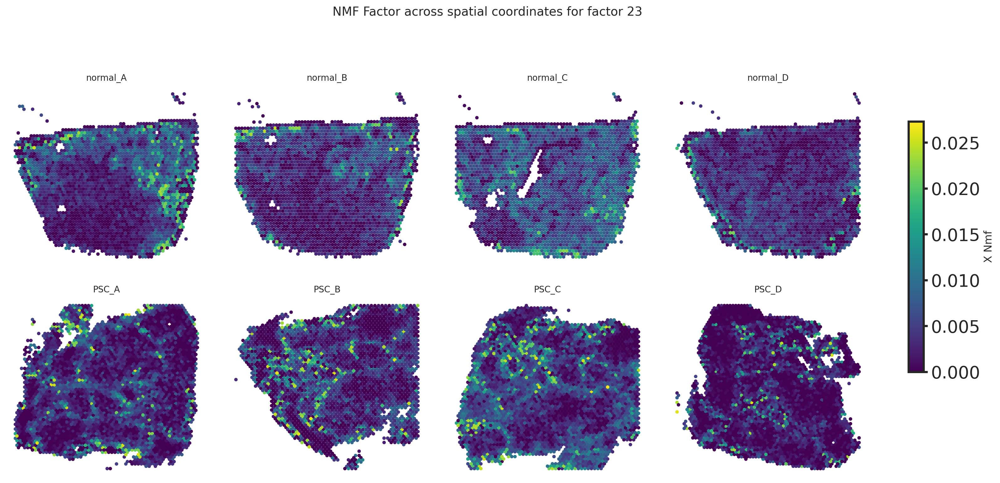

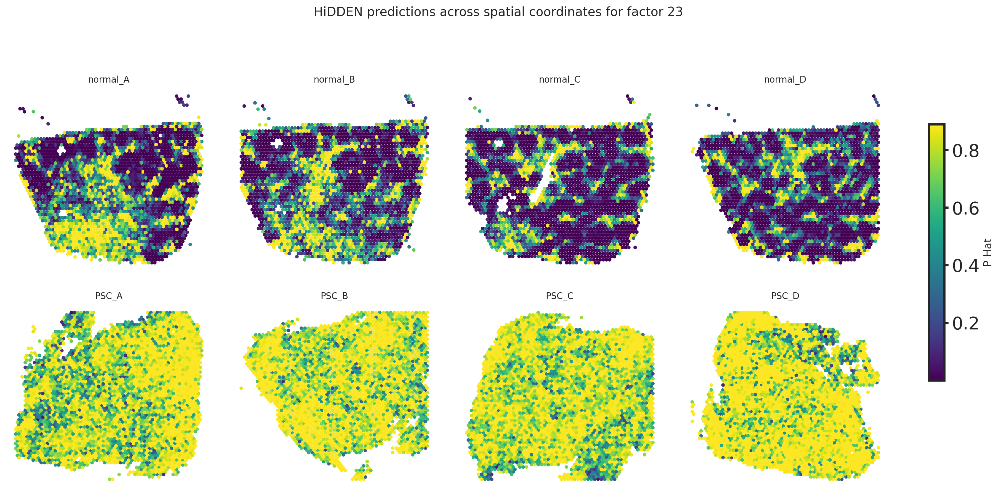

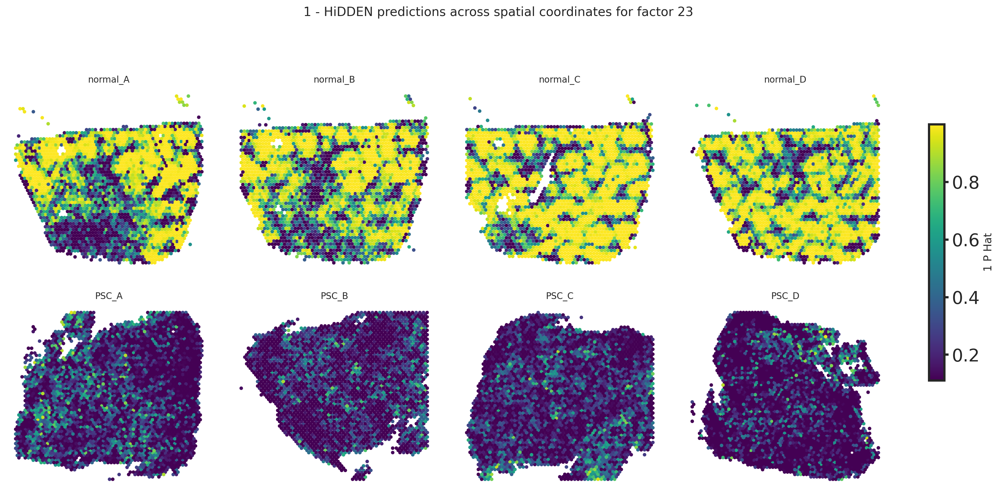

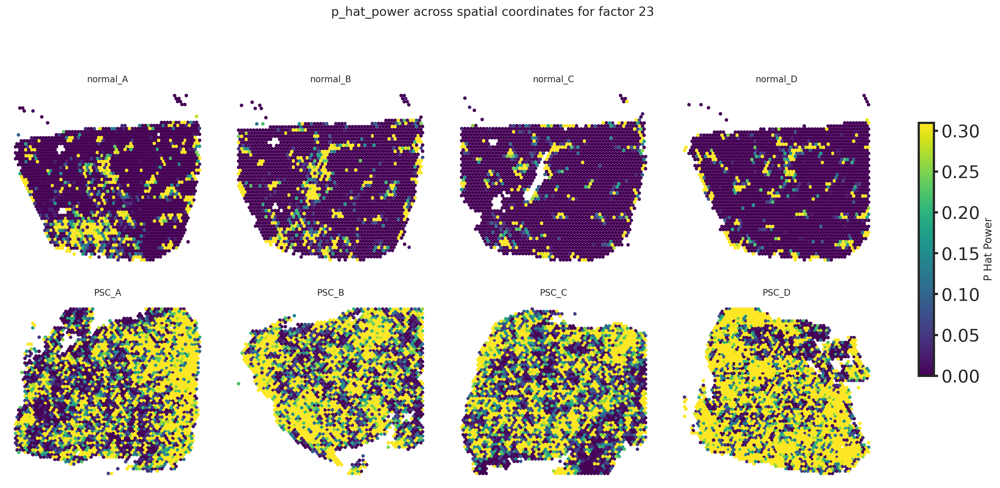

/tmp/ipykernel_1209772/964065628.py:136: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.95])


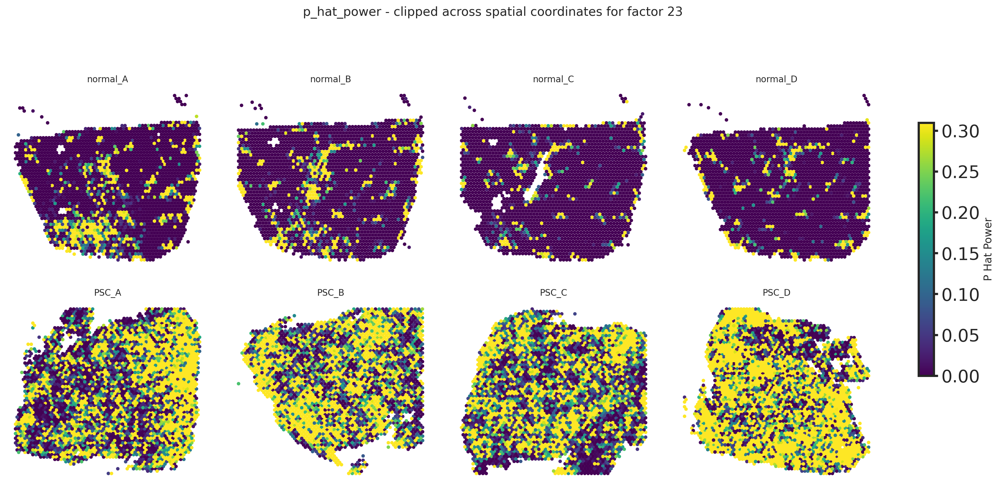

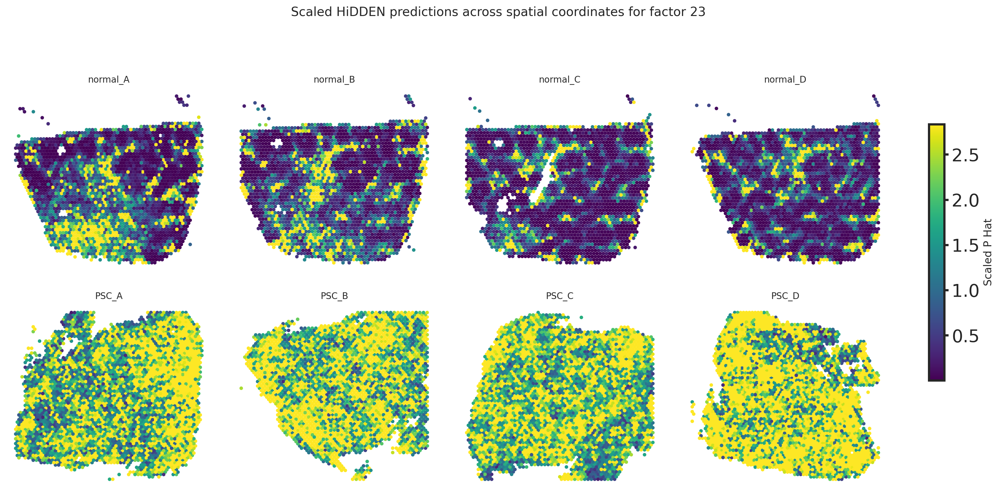

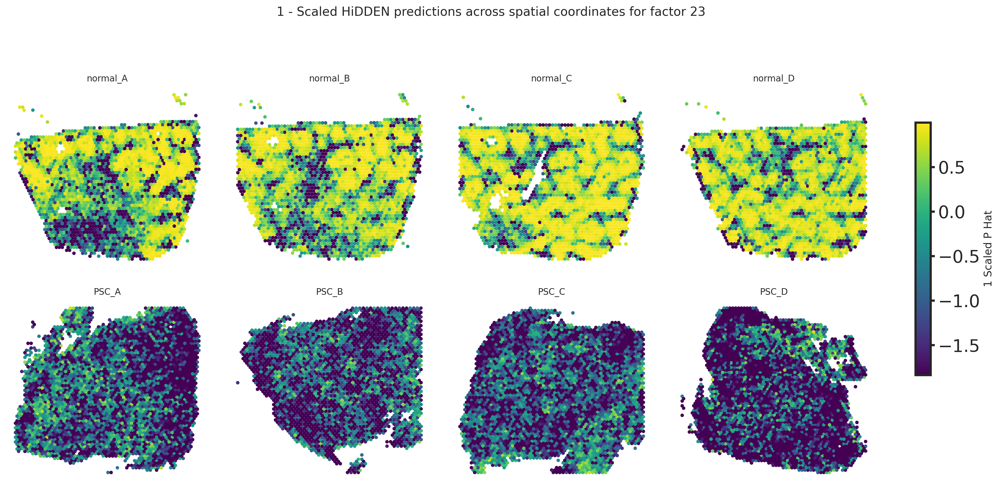

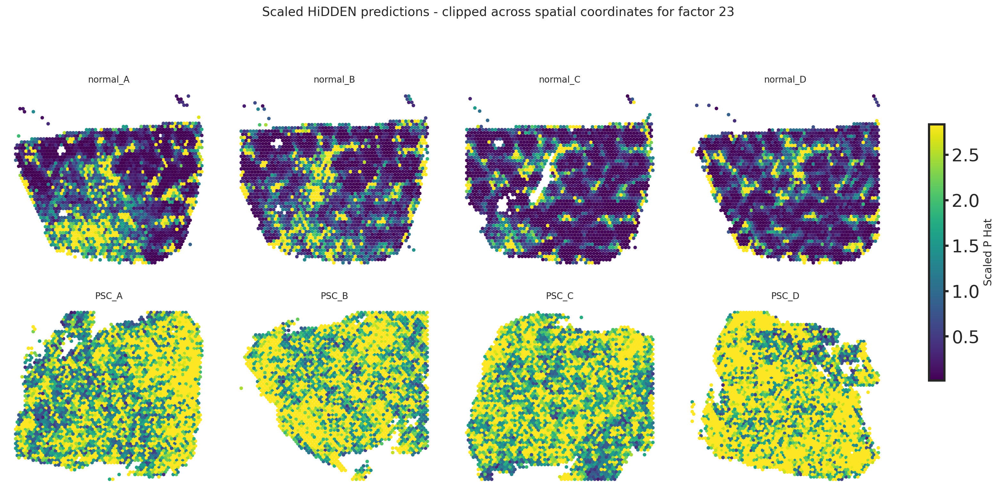

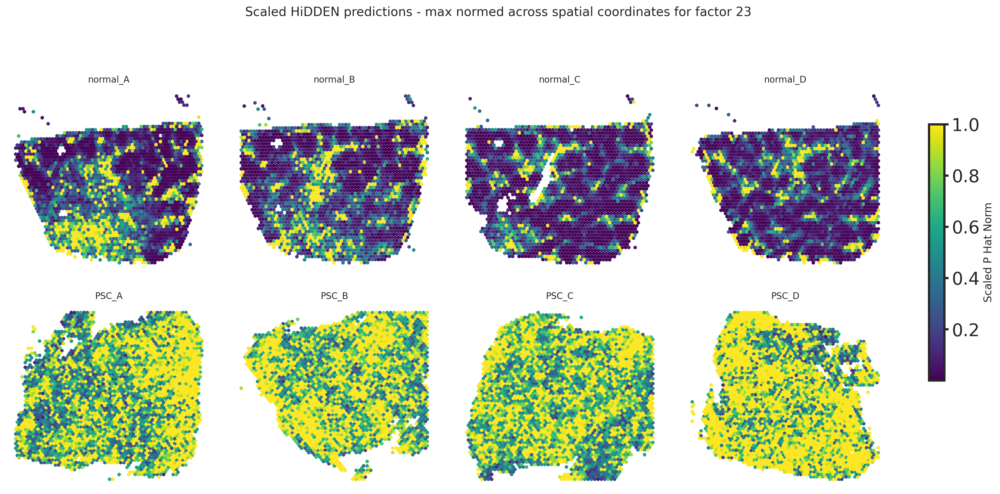

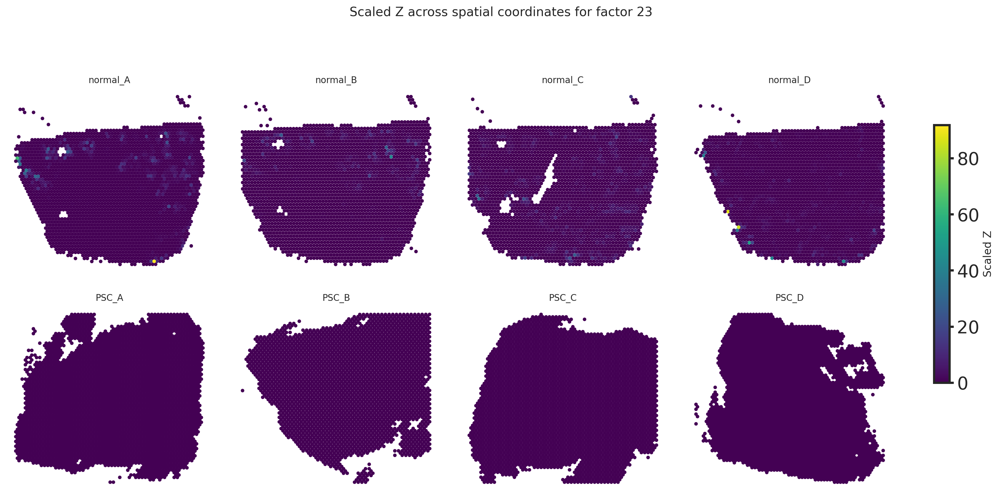

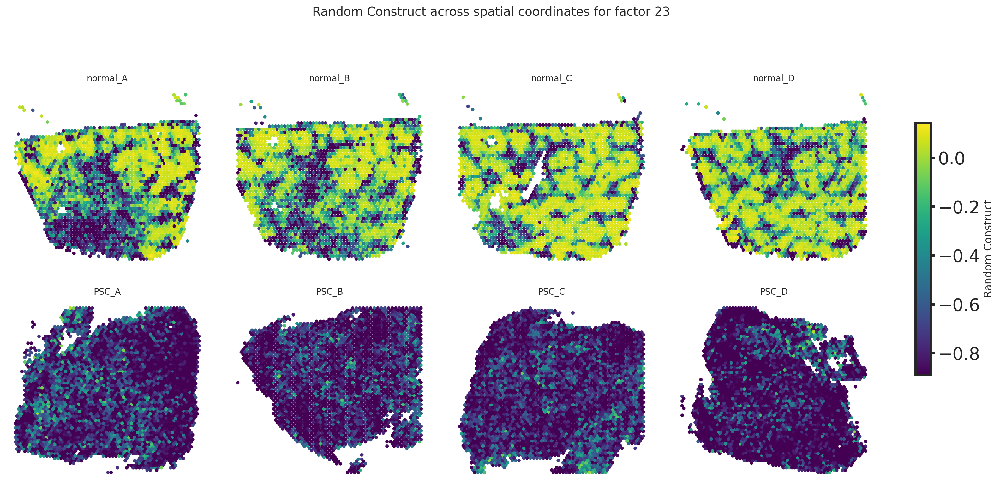

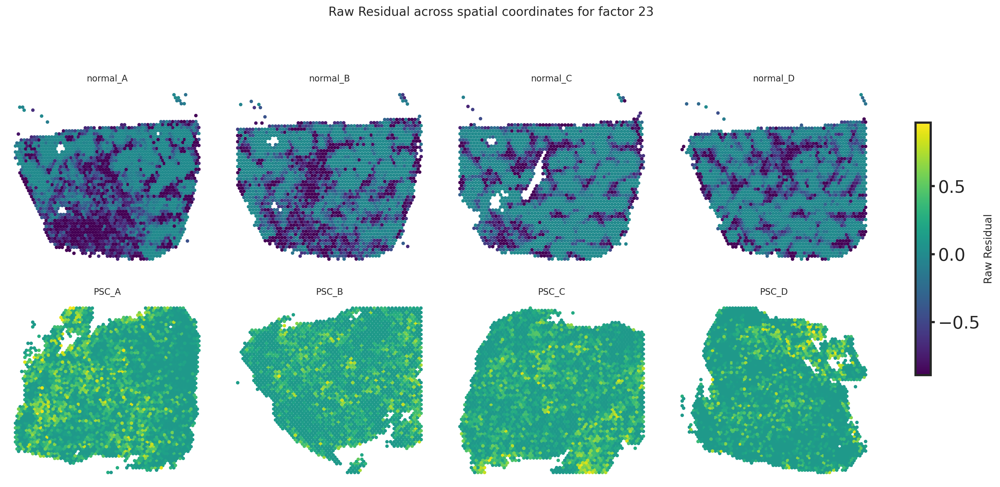

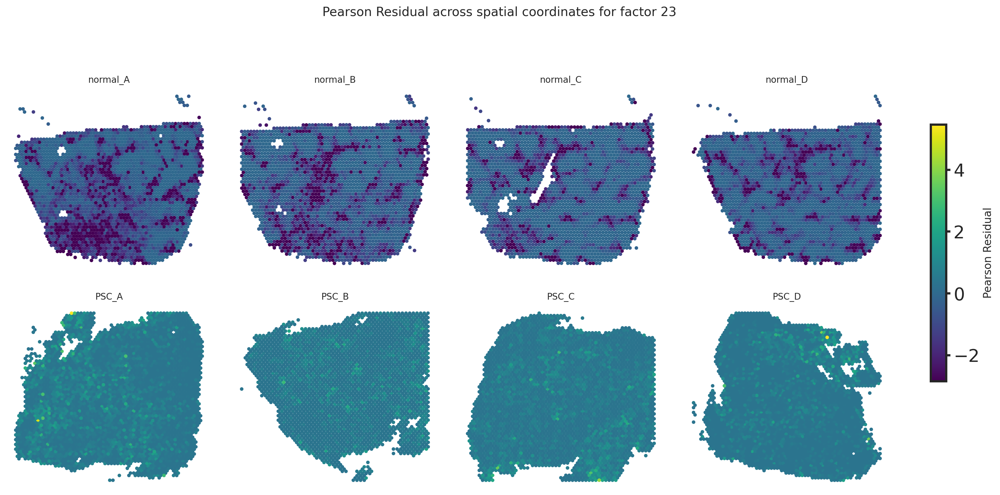

In [115]:

# Plot spatial maps for the first 8 samples
#for i in range(min(8, len(sample_ids))):
#    plot_spatial_p_hat(adata_by_sample[sample_ids[i]], sample_ids[i])

# For NMF factor  (from obsm)
plot_grid(adata_by_sample, sample_ids, key="X_nmf", 
title_prefix="NMF Factor", counter=counter+1, from_obsm=True, factor_idx=3)
# For p_hat
plot_grid(adata_by_sample, sample_ids, key="p_hat", 
title_prefix="HiDDEN predictions", counter=counter+1)

plot_grid(adata_by_sample, sample_ids, key="1_p_hat", 
title_prefix="1 - HiDDEN predictions", counter=counter+1)


plot_grid(adata_by_sample, sample_ids, key="p_hat_power", 
title_prefix="p_hat_power", counter=counter+1)

plot_grid_clipped(adata_by_sample, sample_ids, key="p_hat_power", 
title_prefix="p_hat_power - clipped", counter=counter+1)

# for scaled p_hat
plot_grid(adata_by_sample, sample_ids, key="scaled_p_hat",
title_prefix="Scaled HiDDEN predictions", counter=counter+1)


# for scaled p_hat
plot_grid(adata_by_sample, sample_ids, key="1_scaled_p_hat",
title_prefix="1 - Scaled HiDDEN predictions", counter=counter+1)

plot_grid_clipped(adata_by_sample, sample_ids, key="scaled_p_hat",
title_prefix="Scaled HiDDEN predictions - clipped", counter=counter+1)

# for scaled p_hat
plot_grid(adata_by_sample, sample_ids, key="scaled_p_hat_norm",
title_prefix="Scaled HiDDEN predictions - max normed", counter=counter+1)


plot_grid(adata_by_sample, sample_ids, key="scaled_z",
title_prefix="Scaled Z", counter=counter+1)

plot_grid(adata_by_sample, sample_ids, key="random_construct",
title_prefix="Random Construct", counter=counter+1)

# For raw residuals
plot_grid(adata_by_sample, sample_ids, key="raw_residual", 
                title_prefix="Raw Residual", counter=counter+1)
# For Pearson residuals
plot_grid(adata_by_sample, sample_ids, key="pearson_residual", 
title_prefix="Pearson Residual", counter=counter+1)

#plot.plot_grid(adata_by_sample, sample_ids, key="scaled_random_construct",title_prefix="scaled_random_construct", counter=counter+1)

